In [1]:
import netCDF4 as nc
import glob
import numpy as np
import time as ti
import matplotlib.pylab as py
from IPython.display import display, clear_output
import numpy.ma as ma
import warnings
warnings.filterwarnings('ignore')
from scipy import optimize
import numpy.ma as ma
from scipy.optimize import curve_fit
from scipy.stats import chisquare
import hickle as hkl
import operator
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
import shapely.geometry as shp
import shapely.ops as ops
from rtree import index
from datetime import datetime
import glob
import matplotlib
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.util as cutil
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
import seaborn as sns
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

from functools import partial
import pyproj 

import logging
import time as ti
                
from pathlib import Path
import os
import calendar

import sys
sys.path.append('/data/pragallva/2023_repeat_ERA5/modules/')
import logruns as logruns
import save_and_load_hdf5_files as h5saveload
import netcdf_utilities as ncutil
import os
# os.environ["HDF5_USE_FILE_LOCKING"] = 'FALSE'
from tqdm import tqdm
import glob
from PIL import Image
import copy
import itertools
from datetime import date
import temporal_filter_for_all_years_in_one_level_with_seasonal_cycle as tf
import scipy as sc
from scipy.interpolate import interp1d

NH =''
SH ='S'

import matplotlib
cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", \
              [ "navy",  "dodgerblue", "PowderBlue", "white", \
                "khaki", "orange", "darkred"])

In [2]:
def science_blocks():
    py.plot(-9, 45,   'k*',   markersize=20,)# mfc='none')
    py.plot(-9, 45,   'wo',   markersize=2, )# mfc='none')
    py.plot(-147, 42, 'k*',   markersize=20,)# mfc='none')
    py.plot(-147, 42, 'wo',   markersize=2, )# mfc='none')
import matplotlib.pyplot as plt
plt.rcParams.update({'font.size': 15})

from scipy.signal import savgol_filter

month_names  = {0:'Jan',   1:'Feb',    2:'Mar',    3:'Apr',    4:'May',   5:'Jun',   6:'Jul',    7:'Aug',    8:'Sep',    9:'Oct',    10:'Nov',    11:'Dec'    }
days_no_leap = {  'Jan':31,  'Feb':28,   'Mar':31,   'Apr':30,   'May':31,  'Jun':30,  'Jul':31,   'Aug':31,   'Sep':30,   'Oct':31,    'Nov':30,    'Dec':31 }
days_leap    = {  'Jan':31,  'Feb':29,   'Mar':31,   'Apr':30,   'May':31,  'Jun':30,  'Jul':31,   'Aug':31,   'Sep':30,   'Oct':31,    'Nov':30,    'Dec':31 }

def leap_day(year):
    if calendar.isleap(year+1979):
        return days_leap
    else:
        return days_no_leap

In [3]:
ls /data/pragallva/2023_repeat_ERA5/post_processing/blocking_info_extra_variable/DJF_Ac=65/

1980/     1986.hkl  1993/     1999.hkl  2006/     2012.hkl  2019/
1980.hkl  1987/     1993.hkl  2000/     2006.hkl  2013/     2019.hkl
1981/     1987.hkl  1994/     2000.hkl  2007/     2013.hkl  2020/
1981.hkl  1988/     1994.hkl  2001/     2007.hkl  2014/     2020.hkl
1982/     1988.hkl  1995/     2001.hkl  2008/     2014.hkl  2021/
1982.hkl  1989/     1995.hkl  2002/     2008.hkl  2015/     2021.hkl
1983/     1989.hkl  1996/     2002.hkl  2009/     2015.hkl  banded_data/
1983.hkl  1990/     1996.hkl  2003/     2009.hkl  2016/     input_file/
1984/     1990.hkl  1997/     2003.hkl  2010/     2016.hkl
1984.hkl  1991/     1997.hkl  2004/     2010.hkl  2017/
1985/     1991.hkl  1998/     2004.hkl  2011/     2017.hkl
1985.hkl  1992/     1998.hkl  2005/     2011.hkl  2018/
1986/     1992.hkl  1999/     2005.hkl  2012/     2018.hkl


In [4]:
source_NH                 = '/data/pragallva/2023_repeat_ERA5/post_processing/parameters/'
A_N                       = h5saveload.load_dict_from_hdf5(source_NH+'A_N.hdf5')
lat_N,  lon_N,  A_N_daily = A_N['lat'], A_N['lon'], A_N['field']

In [5]:
ls /data/pragallva/2023_repeat_ERA5/post_processing/full_fields/u_component_of_wind_300_20_80N.hdf5

/data/pragallva/2023_repeat_ERA5/post_processing/full_fields/u_component_of_wind_300_20_80N.hdf5


In [6]:
source_NH     = '/data/pragallva/2023_repeat_ERA5/post_processing/filtered_parameters/seasonal/'
A_N_seasonal  = h5saveload.load_dict_from_hdf5(source_NH+'A_N.hdf5')
lat_N,  lon_N,  A_N_seasonal = A_N['lat'], A_N['lon'], A_N_seasonal['field']

U_N_seasonal  = h5saveload.load_dict_from_hdf5(source_NH+'U_N.hdf5')
lat_N,  lon_N,  U_N_seasonal = A_N['lat'], A_N['lon'], U_N_seasonal['field']


In [7]:
ls /data/pragallva/2023_repeat_ERA5/post_processing/full_fields/

TRASH/                               u_component_of_wind_300_20_80N.hdf5
geopotential_300_20_80N.hdf5         v_component_of_wind_300_20_80N.hdf5
potential_vorticity_300_20_80N.hdf5


In [8]:
source_NH     = '/data/pragallva/2023_repeat_ERA5/post_processing/full_fields/'
u_300         = h5saveload.load_dict_from_hdf5(source_NH+'u_component_of_wind_300_20_80N.hdf5')['field']
z_300         = h5saveload.load_dict_from_hdf5(source_NH+'geopotential_300_20_80N.hdf5')['field']


In [9]:
A0_mini     = A_N_seasonal[:,[0,1,11],...].mean(axis=0).mean(axis=0).mean(axis=0)
annual_mean = np.nanmean(np.nanmean(np.nanmean(A_N_daily, axis=0), axis=0), axis=0)
z300_djf  =  np.nanmean(np.nanmean(np.nanmean(z_300[:,[0,1,11],...], axis=0), axis=0), axis=0) 

In [10]:
A_N  = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/filtered_parameters/band_pass_time_filter_004-infy_days/A_N.hdf5', track=True)
U_N  = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/filtered_parameters/band_pass_time_filter_004-infy_days/U_N.hdf5', track=True)
F1_N = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/filtered_parameters/band_pass_time_filter_004-infy_days/F1_N.hdf5', track=True)
F2_N = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/filtered_parameters/band_pass_time_filter_004-infy_days/F2a_N.hdf5', track=True)
F3_N = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/filtered_parameters/band_pass_time_filter_004-infy_days/F3_N.hdf5', track=True)

100%|██████████| 3/3 [00:04<00:00,  1.43s/it]


In [11]:
A_N_unfiltered  = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/parameters/A_N.hdf5',  track=True)
U_N_unfiltered  = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/parameters/U_N.hdf5',  track=True)
F1_N_unfiltered = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/parameters/F1_N.hdf5', track=True)
F2_N_unfiltered = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/parameters/F2a_N.hdf5', track=True)
F3_N_unfiltered = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/parameters/F3_N.hdf5', track=True)

100%|██████████| 3/3 [00:02<00:00,  1.41it/s]


In [13]:
source_NH   = '/data/pragallva/2023_repeat_ERA5/post_processing/parameters/'
aA_N         = h5saveload.load_dict_from_hdf5(source_NH+'aA_N.hdf5')
lat_N,  lon_N,  aA_N_daily = aA_N['lat'], aA_N['lon'], aA_N['field']

source_NH   = '/data/pragallva/2023_repeat_ERA5/post_processing/parameters/'
cA_N         = h5saveload.load_dict_from_hdf5(source_NH+'cA_N.hdf5')
lat_N,  lon_N,  cA_N_daily = cA_N['lat'], cA_N['lon'], cA_N['field']

## Some functions to calculate other mean fields

In [14]:
import scipy.signal as ss
from scipy import stats
from scipy.linalg import lstsq


def regression_details(x, Y):
        
    Y = Y.reshape(Y.shape[0]*Y.shape[1]*Y.shape[2], Y.shape[3], Y.shape[4])
    x = x.reshape(x.shape[0]*x.shape[1]*x.shape[2], x.shape[3], x.shape[4])

    signall      = np.copy(Y)
    mask         = ~np.isnan(signall)
    nan_mask     =  np.isnan(signall)
    signall[nan_mask] = 0
    signall = ss.detrend(signall,axis=0,type='linear')
    Y     = signall 

    signall      = np.copy(x)
    mask         = ~np.isnan(signall)
    nan_mask     =  np.isnan(signall)
    signall[nan_mask] = 0
    signall = ss.detrend(signall,axis=0,type='linear')
    x    = signall 

    start = ti.time()
    shape = Y.shape
    from scipy import stats
    COEFF   = np.zeros((2, shape[1], shape[2]))
    P_VALUE = np.zeros((   shape[1], shape[2]))
    R_VALUE = np.zeros((   shape[1], shape[2]))
    for lo in tqdm(range(shape[2])):
        for la in range(shape[1]):
            slope, intercept, r_value, p_value, std_err = stats.linregress(x[:,la, lo], Y[:, la, lo])
            COEFF[0, la, lo] = slope
            COEFF[1, la, lo] = intercept
            P_VALUE[la, lo]  = p_value
            R_VALUE[la, lo]  = r_value

    dicti = {'slope':COEFF[0,...], \
             'pvalue':P_VALUE, \
             'rvalue':R_VALUE, \
             'intercept':COEFF[1,...],}
    end   = ti.time()
    return dicti


def polyfit(x, y, degree=2):
    results = {}
    coeffs = np.polyfit(x, y, degree)
    p      = np.poly1d(coeffs)
    #calculate r-squared
    yhat                 =  p(x)
    ybar                 =  np.sum(y)/len(y)
    ssreg                =  np.sum((yhat-ybar)**2)
    sstot                =  np.sum((y - ybar)**2)
    results['r_squared'] =  ssreg/sstot
    results['coeffs']    =  coeffs
    results['Ac']        = -coeffs[1]/(2*coeffs[0])
    results['C']         =  coeffs[2]-coeffs[1]**2/(4*coeffs[0])
    return results


def quadratic_regression_details(x, Y):
        
    Y = Y.reshape(Y.shape[0]*Y.shape[1]*Y.shape[2], Y.shape[3], Y.shape[4])
    x = x.reshape(x.shape[0]*x.shape[1]*x.shape[2], x.shape[3], x.shape[4])

    signall      = np.copy(Y)
    mask         = ~np.isnan(signall)
    nan_mask     =  np.isnan(signall)
    signall[nan_mask] = 0
    signall = ss.detrend(signall,axis=0,type='linear')
    Y     = signall 

    signall      = np.copy(x)
    mask         = ~np.isnan(signall)
    nan_mask     =  np.isnan(signall)
    signall[nan_mask] = 0
    signall = ss.detrend(signall,axis=0,type='linear')
    x    = signall 

    start = ti.time()
    shape = Y.shape
    from scipy import stats
    AC      = np.zeros((shape[1], shape[2]))
    C       = np.zeros((shape[1], shape[2]))
    R_VALUE = np.zeros((shape[1], shape[2]))
    
    COEFFS  = np.zeros((3, shape[1], shape[2]))
    
    for lo in tqdm(range(shape[2])):
        for la in range(shape[1]):
                        
            results = polyfit(x[:,la, lo], Y[:, la, lo], degree=2)

            AC [la, lo]      = results['Ac']
            C  [la, lo]      = results['C']
            R_VALUE[la, lo]  = results['r_squared']
            COEFFS[0,la,lo]  = results['coeffs'][0]
            COEFFS[1,la,lo]  = results['coeffs'][1]
            COEFFS[2,la,lo]  = results['coeffs'][2]
            
    dicti = {'AC':AC, \
             'C' :C, \
             'rvalue':R_VALUE, 'COEFFS':COEFFS}
    end   = ti.time()
    return dicti


def A_F1F2F3(A, F1, F2, F3):
    
    F_linear       = F1+F3
    F_nonlinear    = F2
    
    linear_dict    = regression_details(A, F_linear)
    nonlinear_dict = quadratic_regression_details(A, F_nonlinear)
    
    F_reconstruct = linear_dict['slope'][None,None,None,...]*A + linear_dict['intercept']+\
                    nonlinear_dict['COEFFS'][0][None,None,None,...]*A**2 + \
                    nonlinear_dict['COEFFS'][1][None,None,None,...]*A    + \
                    nonlinear_dict['COEFFS'][2][None,None,None,...]
    
    dicti = {'linear':linear_dict, 'nonlinear':nonlinear_dict, 'F_reconstruct':F_reconstruct}
    return dicti


# import scipy.signal as ss
# from scipy import stats
# from scipy.linalg import lstsq


def covariance_matrix(x, Y):
        
    Y = Y.reshape(Y.shape[0]*Y.shape[1]*Y.shape[2], Y.shape[3], Y.shape[4])
    x = x.reshape(x.shape[0]*x.shape[1]*x.shape[2], x.shape[3], x.shape[4])

    signall      = np.copy(Y)
    mask         = ~np.isnan(signall)
    nan_mask     =  np.isnan(signall)
    signall[nan_mask] = 0
    signall = ss.detrend(signall,axis=0,type='linear')
    Y     = signall 

    signall      = np.copy(x)
    mask         = ~np.isnan(signall)
    nan_mask     =  np.isnan(signall)
    signall[nan_mask] = 0
    signall = ss.detrend(signall,axis=0,type='linear')
    x    = signall 

    start = ti.time()
    shape = Y.shape
    from scipy import stats
    COV     = np.zeros((shape[1], shape[2]))
    VARx    = np.zeros((shape[1], shape[2]))
    VARy    = np.zeros((shape[1], shape[2]))
    
    P_VALUE = np.zeros((   shape[1], shape[2]))
    R_VALUE = np.zeros((   shape[1], shape[2]))
    
    for lo in tqdm(range(shape[2])):
        for la in range(shape[1]):
            COV[la,lo]  = np.cov(x[:, la, lo], Y[:, la, lo])[0][1]
            VARx[la,lo] = np.cov(x[:, la, lo], Y[:, la, lo])[0][0]
            VARy[la,lo] = np.cov(x[:, la, lo], Y[:, la, lo])[1][1]

    dicti = {'COV':COV, \
             'VARx':VARx, \
             'VARy':VARy,}
    
    end   = ti.time()

    return dicti



In [15]:
# Add a map here 
def plot_cluster_with_map_modified_for_subplots(TITLE='Spatial distribution of persistent wave-activity',\
                          DATA = np.nanmean(A0_mini,axis=0),\
                          LRANGE = np.arange(-110,-0, 10),\
                          CMAP  = matplotlib.colors.LinearSegmentedColormap.from_list("", \
                                  [ "navy", "skyblue", "khaki",  "white", ]),\
                          LEGEND_LOCATION='upper right', ALPHA=0.8, lat_N=lat_N, track_events=True, \
                          source = '/data/pragallva/2023_repeat_ERA5/post_processing/blocking_info_extra_variable/DJF_Ac=65/banded_data/', \
                          lat_locations='ALL', EXTRA='DELETE_REDUNDANT_BLOCKS', block_type='anticyclonic', \
                          xlabelling = True, fig=None, fig_no = 111, block_legends=True, bbox_to_anchor=(0, -0.40), contour_color='w', \
                          hatches = False, zcontours = None, zcmap=None):
    
            
#             zcontours = [-200, -150, -100, -50, 50, 100, 150, 200]
            def plot_individidual_event_circles(blocking_details_day_wise, axes, persistence_length, \
                                                projection, alpha, color, markeredgecolor, markersize, marker):
                      
                    DAYS = list(blocking_details_day_wise.keys())
                    for DAY in DAYS:
                        day = int(DAY.split('days')[-1])

                        if day in persistence_length:
                            for block_no in blocking_details_day_wise[DAY].keys():
                                xy = blocking_details_day_wise[DAY][block_no]['location']

                                if color == 'k':
                                      axes.plot(*(xy), '.', alpha=0.8, color='k', \
                                                transform=projection, mfc='none', markersize=10,  marker='o')
                                else:
                                      axes.plot(*(xy), '.', alpha=alpha, color=color,transform=projection, markeredgewidth=2, \
                                                markeredgecolor=markeredgecolor, markersize=markersize, marker=marker)


            def plot_tracked_events(axes, persistence_length = range(3,5), color='gray', alpha=0.6, \
                                    markeredgecolor=None, markersize=18, projection=ccrs.PlateCarree(), marker='o'):    
                
                
                for lon_region in os.listdir(source):
                    
                    if lat_locations=='ALL':
                        lat_regions = os.listdir(source+'/%s/'%(lon_region))
                    else:
                        lat_regions = [lat_locations]
                        
                    for lat_region in lat_regions:
                        blocking_details_day_wise = hkl.load('%s/%s/%s/%s/blocking_details_day_wise.hkl'%(source, lon_region, lat_region, EXTRA)) 
                        
                        if EXTRA == 'DELETE_REDUNDANT_BLOCKS':
                            blocking_details_day_wise = blocking_details_day_wise 
                            plot_individidual_event_circles(blocking_details_day_wise, axes, persistence_length, projection, alpha, color, markeredgecolor, markersize, marker)
                            
                        elif (EXTRA != 'DELETE_REDUNDANT_BLOCKS') and (block_type in blocking_details_day_wise.keys()):
                            blocking_details_day_wise = blocking_details_day_wise[block_type]
                            plot_individidual_event_circles(blocking_details_day_wise, axes, persistence_length, projection, alpha, color, markeredgecolor, markersize, marker)
                            
                        else:
                            0
                            
            def custom_block_legends(fs=20, location='best'):
                from matplotlib.lines import Line2D
                custom_lines = [Line2D([0], [0], marker='o', color='w' , mfc='none', markersize=15, markeredgecolor='gray', markeredgewidth=2),
                                Line2D([0], [0], marker='o', markerfacecolor='lime',color='w' ,  markersize=15, markeredgecolor='k'),
                                Line2D([0], [0], marker='o', markerfacecolor='orange', color='w',  markersize=15, markeredgecolor='k'),
                                Line2D([0], [0], marker='o', markerfacecolor='maroon', color='w', markersize=18, markeredgecolor='w'),]

                py.legend(custom_lines, ['4-5 days', '6-8 days', '9-11 days', '12-17 days'], ncol=2, fontsize=fs, loc=location, bbox_to_anchor = bbox_to_anchor)
                            

            def plotLWA_and_blocking_events(field=A_N_daily, variable='LWA', \
                                            x=lon_N, y=lat_N, plot_field=True, format='%1d', \
                                            color='r',plot_specific=0, axes=None, projection=ccrs.PlateCarree(), ):

                if axes is None:
                    axes=py

                def science_blocks():
                    axes.plot(-9, 45,   'k*',   markersize=20,transform=projection)# mfc='none')
                    axes.plot(-9, 45,   'wo',   markersize=2, transform=projection)# mfc='none')
                    axes.plot(-147, 42, 'k*',   markersize=20,transform=projection)# mfc='none')
                    axes.plot(-147, 42, 'wo',   markersize=2, transform=projection)# mfc='none')
                import matplotlib.pyplot as plt
                plt.rcParams.update({'font.size': 15})


                Y     = 2022
                start = 1980
                LWA_mean=[]
                
                if track_events:    
                    plot_tracked_events(axes,  persistence_length = range(4,5+1),   color='k', markersize=10, projection=projection)
                    plot_tracked_events(axes,  persistence_length = range(6,8+1),   color='lime', markeredgecolor='k',   markersize=15, projection=projection,  marker='o')
                    plot_tracked_events(axes,  persistence_length = range(9,11+1),  color='orange', markeredgecolor='k', markersize=20, projection=projection, alpha=0.8, marker='o')
                    plot_tracked_events(axes,  persistence_length = range(12,17+1), color='maroon', markeredgecolor='w', markersize=25,projection=projection, alpha=0.6, marker='o')
                    if block_legends is True:
                        custom_block_legends(fs=default_size_label, location=LEGEND_LOCATION)

                if plot_field:
                    c=axes.contour(x, y, np.nanmean(LWA_mean, axis=0), colors=color, linewidths=2.0,transform=projection)
                    axes.clabel(c, fontsize=18, fmt=format)
                if plot_specific:
                    c=axes.contour(x, y, np.nanmean(LWA_mean, axis=0), [plot_specific], color='k', linewidths=4.0, transform=projection)
                    axes.clabel(c, fontsize=15, fmt=format)

                axes.set_ylim([20,80])
                axes.set_xlim([-180,180])

#                 science_blocks()

                if plot_field:
                    return np.nanmean(LWA_mean, axis=0)


            CL=-90
            projection=ccrs.PlateCarree(central_longitude=CL)


            ax = fig.add_subplot(fig_no, projection=projection)
            matplotlib.rcParams['contour.negative_linestyle'] = 'solid'
            LWA_all=plotLWA_and_blocking_events(field=A_N_daily, variable='LWA', plot_field=False, axes=ax, projection=ccrs.PlateCarree())
            cyclic_data, cyclic_lons = cutil.add_cyclic_point(data=DATA, coord=lon_N)
            
            cyclic_data_z300, cyclic_lons = cutil.add_cyclic_point(data=z300_djf, coord=lon_N)
            
            def star(Y):
                return ((Y - Y.mean(axis=-1)[:,None])*np.cos(np.deg2rad(lat_N)[:,None]))/9.8 ### In meters
            
            if not hatches:
                im = ax.contourf(cyclic_lons,lat_N, cyclic_data, LRANGE, \
                              cmap=CMAP, transform=ccrs.PlateCarree(), alpha=ALPHA, extend='both'); #fig.colorbar(c)
                ax.contour(cyclic_lons,lat_N, cyclic_data,    LRANGE, \
                              colors=contour_color, transform=ccrs.PlateCarree(), alpha=ALPHA); #fig.colorbar(c)

                if zcontours is not None:
                    c= ax.contour(cyclic_lons, lat_N, star(cyclic_data_z300),    zcontours, \
                               cmap=zcmap, transform=ccrs.PlateCarree(), alpha=1, linewidths=5); #fig.colorbar(c)
                    clabels = ax.clabel(c, fmt="%1d", inline=True, fontsize=default_size_label-2)
#                     [txt.set_backgroundcolor('white') for txt in clabels]
        
                ax.set_title(TITLE,fontsize=default_size_title, y=1.01)
            
            else:
                im=ax.contourf(cyclic_lons,lat_N, cyclic_data, 5, colors='none', \
                              hatches=['/'], transform=ccrs.PlateCarree()); #fig.colorbar(c)
                
            ax.set_aspect('auto')
#             ax.add_feature(cfeature.NaturalEarthFeature('physical', 'land', '50m', edgecolor='face', facecolor='thistle', alpha=0.5))

            ax.coastlines(linestyle='-', color='k')

            ax.set_xticks([-180, -120, -60, 0, 60, 120, 180], crs=projection)
            ax.set_yticks([-75, -50, -25, 0, 25, 50, 75], crs=projection)
            ax.set_extent((0-CL, 360+CL, 20, 80), crs=projection)
            lon_formatter = LongitudeFormatter(zero_direction_label=True)
            lat_formatter = LatitudeFormatter()
            ax.xaxis.set_major_formatter(lon_formatter)
            ax.yaxis.set_major_formatter(lat_formatter)
            ax.set_ylabel('Latitude', fontsize=default_size_label)
            
            ax.tick_params(labelsize=default_size_label, labelbottom=xlabelling)
            if xlabelling:
                ax.set_xlabel('Longitude', fontsize=default_size_label)   
                
            return ax, im


In [16]:

source = '/data/pragallva/2023_repeat_ERA5/post_processing/blocking_info_extra_variable/DJF_Ac=65/banded_data/'
def get_tracked_events_aggregated(persistence_length = range(5,6), EXTRA='', lat_locations='ALL', block_type='anticyclonic', plot_axis='lon'):

    axes = {'lon': 0, 'lat':1}
    
    X_LOC = []
    for lon_region in os.listdir(source):
        if lat_locations=='ALL':
            lat_regions = os.listdir(source+'/%s/'%(lon_region))
        else:
            lat_regions = [lat_locations]
        for lat_region in lat_regions:
            blocking_details_day_wise = hkl.load('%s/%s/%s/%s/blocking_details_day_wise.hkl'%(source, lon_region, lat_region, EXTRA))
            
            if EXTRA == 'DELETE_REDUNDANT_BLOCKS':
                DAYS = list(blocking_details_day_wise.keys())
                for DAY in DAYS:
                    day = int(DAY.split('days')[-1])
                    if day in persistence_length:
                        for block_no in blocking_details_day_wise[DAY].keys():
                            xy = blocking_details_day_wise[DAY][block_no]['location']  
                            X_LOC.append(xy[axes[plot_axis]]) 
                            
            if (EXTRA != 'DELETE_REDUNDANT_BLOCKS') and (block_type in blocking_details_day_wise.keys()):
                DAYS = list(blocking_details_day_wise[block_type].keys())
                for DAY in DAYS:
                    day = int(DAY.split('days')[-1])
                    if day in persistence_length:
                        for block_no in blocking_details_day_wise[block_type][DAY].keys():
                            xy = blocking_details_day_wise[block_type][DAY][block_no]['location']  
                            X_LOC.append(xy[axes[plot_axis]])                                    
    return X_LOC


# py.figure(figsize=(15,4))
# X_LOC = get_tracked_events_aggregated(persistence_length = range(3,20), EXTRA='DELETE_REDUNDANT_BLOCKS', lat_locations='lat45-60')
# sns.histplot(X_LOC, bins=30, kde=True, color='blue', alpha=0.5)
# X_LOC = get_tracked_events_aggregated(persistence_length = range(3,20), EXTRA='DELETE_REDUNDANT_BLOCKS', lat_locations='lat30-45')
# sns.histplot(X_LOC, bins=30, kde=True, color='red')
# X_LOC = get_tracked_events_aggregated(persistence_length = range(3,20), EXTRA='DELETE_REDUNDANT_BLOCKS', lat_locations='lat20-30')
# sns.histplot(X_LOC, bins=30, kde=True, color='green', alpha=1)
# X_LOC = get_tracked_events_aggregated(persistence_length = range(3,20), EXTRA='DELETE_REDUNDANT_BLOCKS', lat_locations='lat60-75')
# sns.histplot(X_LOC, bins=30, kde=True, color='orange', alpha=1)


def function_to_plot_lon_distribution(fig, fig_no=512, default_size_label=30):
    
        CL   = -90
        projection=ccrs.PlateCarree(central_longitude=CL)
        ax   = fig.add_subplot(fig_no, projection=projection)

        source_full_fields = '/data/pragallva/2022_repeat_ERA5/post_processing/full_fields/'
        Z300 = h5saveload.load_dict_from_hdf5(source_full_fields+'geopotential_300_20_80N.hdf5')
        lat_z, lon_z, geopot_300 = Z300['lat'], Z300['lon'], Z300['field']
        geopot_300_DJF = np.nanmean(np.nanmean(np.nanmean(geopot_300[:,[0,1,11],...], axis=0), axis=0), axis=0)
        A0_DJF         = np.nanmean(np.nanmean(np.nanmean( A_N_daily[:,[0,1,11],...], axis=0), axis=0), axis=0)
   

        X_LOC_anticyclonic = get_tracked_events_aggregated(persistence_length = range(4,20), \
                                                           EXTRA='BlOCK_TYPES_DIVISION_LWA_based', lat_locations='ALL', block_type='anticyclonic')
        X_LOC_cyclonic     = get_tracked_events_aggregated(persistence_length = range(4,20), \
                                                           EXTRA='BlOCK_TYPES_DIVISION_LWA_based', lat_locations='ALL', block_type='cyclonic')


        HIST0, HIST1, HIST2 = \
                 ax.hist([X_LOC_cyclonic, X_LOC_anticyclonic],  bins=50, histtype='barstacked', \
                 color=['red', 'blue'], alpha=0.5, edgecolor='k', transform=ccrs.PlateCarree(), rwidth=0.8, \
                 linewidth=2, label = ['cyclonic', 'anticyclonic'])
        mini = -10; maxi = np.max(HIST0)+10
        ax.set_aspect(1.8)
        ax.legend(loc='upper left', frameon=False, fontsize=default_size_label)
        ax.set_xticks([-180, -120, -60, 0, 60, 120, 180], crs=projection)
        lon_formatter = LongitudeFormatter(zero_direction_label=True)
        ax.xaxis.set_major_formatter(lon_formatter)
        ax.set_xlabel('Longitude',        fontsize=default_size_label, y=0-0.1)
        ax.set_ylabel('Number of events \n (red & blue bars)', fontsize=default_size_label)
        ax.tick_params(labelsize=default_size_label)
        ax.set_title(r'Longitudinal distribution of cyclonic and anticyclonic blocking events', fontsize=default_size_label+2, y=1.02)
        
        
        labelcolor='orange'
        ax2 = ax.twinx()
        DATA = (A0_DJF) #+annual_mean    
        cyclic_data, cyclic_lons = cutil.add_cyclic_point(data=DATA, coord=lon_N)
        ax2.plot(cyclic_lons, np.roll(cyclic_data.mean(axis=0), -CL), color=labelcolor, linewidth=5, alpha=1, label=r'$\mathcal{A}_o\ \mathcal{\cos\phi}$')
        ax2.set_xlim(-180, 180)
        ax2.tick_params(labelsize=default_size_label, labelcolor=labelcolor)
        ax2.legend(loc='upper right', frameon=False, fontsize=default_size_label+3, bbox_to_anchor=(0.99, 0.99))
        ax2.set_ylabel('LWA [m/s]', fontsize=default_size_label, color=labelcolor, fontweight='bold', labelpad=10)           

        ax1 = ax.twinx()
        labelcolor = 'k'
        DATA       =  geopot_300_DJF/(1000*9.8)
        cyclic_data, cyclic_lons = cutil.add_cyclic_point(data=DATA, coord=lon_N)
        ax1.plot(cyclic_lons, np.roll(cyclic_data.mean(axis=0), -CL), '--', color=labelcolor, linewidth=3, alpha=1, label=r'$[{Z}_{300}]$')
        ax1.set_xlim(-180, 180)
        ax1.tick_params(labelsize=default_size_label, labelcolor=labelcolor)
        ax1.legend(loc='upper right', frameon=False, fontsize=default_size_label-2, bbox_to_anchor=(0.99, 0.85))
        ax1.set_ylabel('geopot. ht. [km]', fontsize=default_size_label, color=labelcolor, fontweight='bold', labelpad=10)
        ax1.spines['right'].set_position(("axes", 1.09))
     
        return ax


In [17]:
# py.plot(nanmean(U_N_unfiltered['field'][:-1,...].mean(axis=-1)))

## Calculate the different mean field quantities

In [18]:
dicti_AUCos = regression_details(A_N['field'][:-1, [11,0,1], ...], \
                                 U_N['field'][:-1, [11,0,1], ...]*np.cos(np.deg2rad(lat_N))[None,None,None,:,None])

100%|██████████| 360/360 [00:11<00:00, 30.21it/s]


In [19]:
dicti_AU     =  regression_details(A_N['field'][:-1, [11,0,1], ...], U_N['field'][:-1, [11,0,1], ...])

100%|██████████| 360/360 [00:13<00:00, 26.60it/s]


In [20]:
dicti_aAU     =  regression_details(aA_N['field'][:-1, [11,0,1], ...], U_N['field'][:-1, [11,0,1], ...])
dicti_cAU     =  regression_details(cA_N['field'][:-1, [11,0,1], ...], U_N['field'][:-1, [11,0,1], ...])

100%|██████████| 360/360 [00:14<00:00, 24.59it/s]


In [21]:
# py.contourf(dicti_aAU['slope']); py.colorbar()

In [22]:
covar_AUCos  =  covariance_matrix(A_N['field'][:-1, [11,0,1], ...], \
                                  U_N['field'][:-1, [11,0,1], ...]*np.cos(np.deg2rad(lat_N))[None,None,None,:,None])

100%|██████████| 360/360 [00:19<00:00, 18.19it/s]


In [23]:
F_N_unfiltered = (F1_N_unfiltered['field'] + F2_N_unfiltered['field']  + F3_N_unfiltered['field'])[:-1,...]

In [24]:
dicti_AUCos_unfiltered = regression_details(A_N_unfiltered['field'][:-1, [11,0,1], ...], \
                                            U_N_unfiltered['field'][:-1, [11,0,1], ...]*np.cos(np.deg2rad(lat_N))[None,None,None,:,None])

100%|██████████| 360/360 [00:12<00:00, 29.23it/s]


In [25]:
dicti_AU_unfiltered = regression_details(A_N_unfiltered['field'][:-1, [11,0,1], ...], \
                                         U_N_unfiltered['field'][:-1, [11,0,1], ...])

100%|██████████| 360/360 [00:13<00:00, 27.68it/s]


In [26]:
A_F_relation  = quadratic_regression_details(A_N_unfiltered['field'][:-1, [11,0,1], ...], \
                                             F_N_unfiltered[:, [11,0,1], ...])

100%|██████████| 360/360 [00:21<00:00, 16.74it/s]


In [27]:
A_F1F2F3_relation = A_F1F2F3( A_N_unfiltered['field'][:-1, [11,0,1], ...], F1_N_unfiltered['field'][:-1, [11,0,1], ...], \
                             F2_N_unfiltered['field'][:-1, [11,0,1], ...], F3_N_unfiltered['field'][:-1, [11,0,1], ...])

100%|██████████| 360/360 [00:20<00:00, 17.62it/s]


In [28]:
A_F3_relation = regression_details( A_N_unfiltered['field'][:-1, [11,0,1], ...], \
                                   F3_N_unfiltered['field'][:-1, [11,0,1], ...])

100%|██████████| 360/360 [00:12<00:00, 28.74it/s]


In [29]:
# A_F3_relation

In [30]:
A_F1F2F3_relation.keys()

dict_keys(['linear', 'nonlinear', 'F_reconstruct'])

In [31]:
Uref = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/parameters/Uref_N.hdf5')
UREF = np.nanmean (np.nanmean(np.nanmean(Uref['field'][:-1,[11,0,1],:,:,0],axis=0), axis=0), axis=0)

In [32]:
Uref['field'].shape

(44, 12, 31, 60, 1)

## Plot the cluster map

## LWA total

In [34]:
# list(VARIABLES.keys())[0]

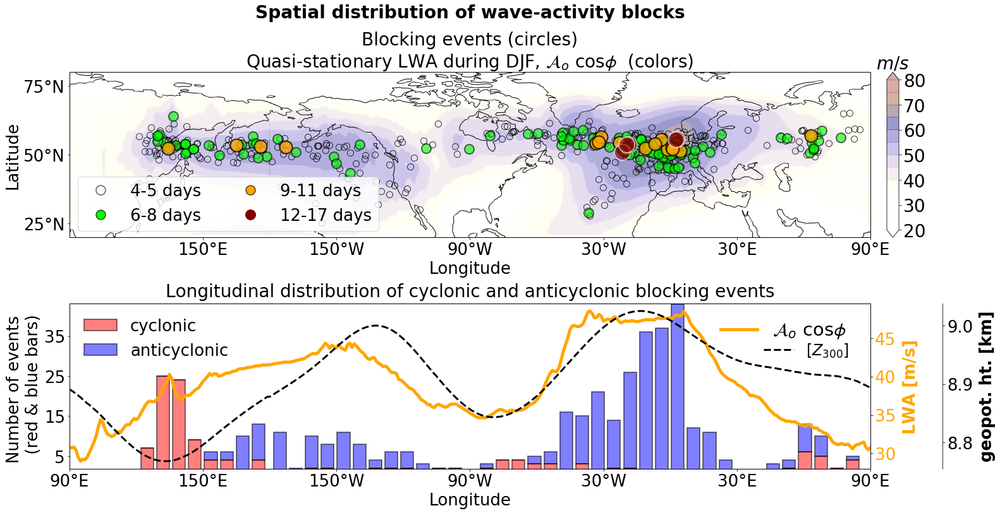

In [44]:
def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
    
    
VARIABLES = {'LWA'              :  {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                    'block_legend': True, \
                                    'title': r'Blocking events (circles)'+ \
                                              '\n'r'Quasi-stationary LWA during DJF, ${\mathcal{A}_o}\ \mathcal{\cos\phi}$  (colors)' }, \
          
             'Anticyclonic LWA'  : {'EXTRA': 'BlOCK_TYPES_DIVISION_LWA_based', \
                                    'block_type':'anticyclonic', 'block_legend': False, \
                                   'title': r'Anticyclonic events and anticyclonic $A_o$'}, \
          
             'Cyclonic LWA'      : {'EXTRA': 'BlOCK_TYPES_DIVISION_LWA_based', \
                                    'block_type':'cyclonic', 'block_legend':     True, \
                                    'title': r'Cyclonic events and cyclonic $A_o$'}, }

source_file = {'LWA':              nanmean(A_N_daily), \
               'Anticyclonic LWA': nanmean(aA_N['field']), \
               'Cyclonic LWA':     nanmean(cA_N['field'])}

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])


cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])


CMAP  = matplotlib.colors.LinearSegmentedColormap.from_list("", \
      ["brown", "saddlebrown", "navy", "slateblue", "thistle", "lightyellow", "white", "white",][::-1])


lrange0 = np.arange(20, 85, 5)
lrange1 = np.arange(10, 55, 5)
lranges  = [lrange0, lrange1, lrange1]


default_size_label   = 25+1
default_size_title   = 25+3
default_size_contour = 16+2

fig = py.figure(figsize=(22,30))

from mpl_toolkits.axes_grid1.inset_locator import inset_axes


key = list(VARIABLES.keys())[0]  
enum = 0
# xlabelling = True if enum == 0 else False
xlabelling = True
ax, im = plot_cluster_with_map_modified_for_subplots( TITLE  =  VARIABLES[key]['title'], \
                                                      DATA   =  source_file[key], \
                                                      LRANGE =  lranges[enum],           \
                                                      CMAP   =  CMAP,     \
                                                      LEGEND_LOCATION = 'lower left', \
                                                      ALPHA = 0.4, track_events=True, \
                                                      xlabelling = xlabelling, fig=fig, fig_no = 511+enum, \
                                                      EXTRA=VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                                                      block_legends = VARIABLES[key]['block_legend'], bbox_to_anchor=(0, -0.01), contour_color='w', \
                                                      zcontours = None)    

axins = inset_axes(ax, width="1.5%",   height="100%", loc=5, borderpad=-3)
cbar =  fig.colorbar(im, cax=axins, orientation="vertical")
for t in cbar.ax.get_yticklabels():
    t.set_fontsize(default_size_label+2)
cbar.ax.set_title(r'$m/s$', fontsize=default_size_title)

enum=1
ax = function_to_plot_lon_distribution(fig, fig_no = 511+enum, default_size_label=default_size_label)
ax.set_ylim(-35, 80)
ax.set_yticks([5,15,25,35,45])
fig.subplots_adjust(left=0.1, bottom=0.1, right=0.9, 
                    top=0.9, wspace=0.2, hspace=0.4)
                      
fig.suptitle('Spatial distribution of wave-activity blocks', fontsize = default_size_title, y=0.95,fontweight='bold')


# dest = './'
# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Spatial_distribution_blocks.png',  dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Spatial_distribution_blocks.pdf',           bbox_inches='tight')
fig.tight_layout()
fig.show()

In [143]:
A_N_seasonal['field'].shape

(44, 12, 31, 60, 360)

In [145]:
source_full_fields = '/data/pragallva/2022_repeat_ERA5/post_processing/full_fields/'
Z300 = h5saveload.load_dict_from_hdf5(source_full_fields+'geopotential_300_20_80N.hdf5')
Z300['field'].shape

(43, 12, 31, 60, 360)

## Plot $\mathcal{A} _o$ after removing the annual mean 

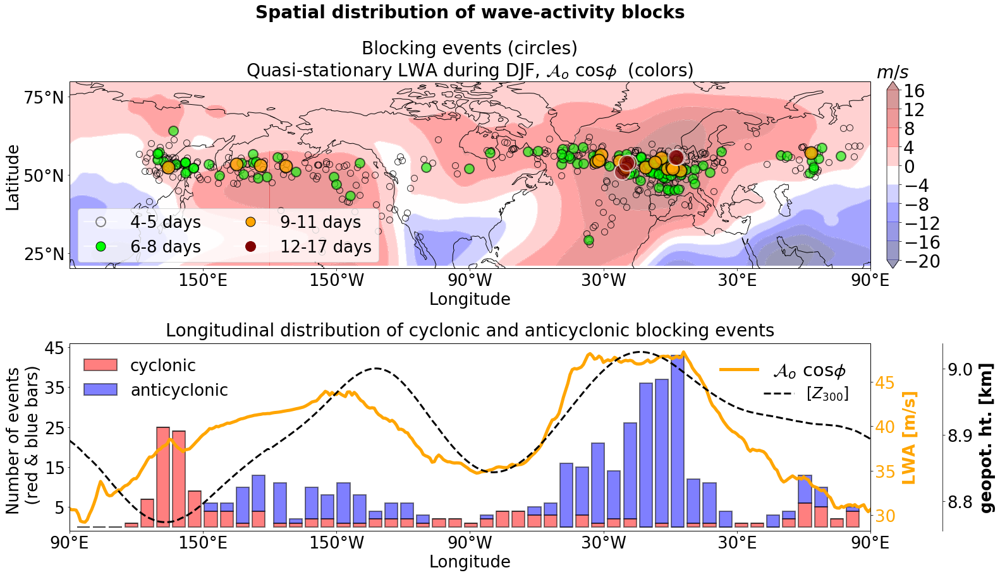

In [150]:
def function_to_plot_lon_distribution(fig, fig_no=512, default_size_label=30):
    
        CL   = -90
        projection=ccrs.PlateCarree(central_longitude=CL)
        ax   = fig.add_subplot(fig_no, projection=projection)

        source_full_fields = '/data/pragallva/2022_repeat_ERA5/post_processing/full_fields/'
        Z300 = h5saveload.load_dict_from_hdf5(source_full_fields+'geopotential_300_20_80N.hdf5')
        lat_z, lon_z, geopot_300 = Z300['lat'], Z300['lon'], Z300['field']
        geopot_300_DJF = np.nanmean(np.nanmean(np.nanmean(geopot_300[:,[0,1,11],...], axis=0), axis=0), axis=0)
#         geopot_300_DJF = geopot_300_DJF-geopot_300_DJF.mean(axis=-1)[:,None]
        A0_DJF         = np.nanmean(np.nanmean(np.nanmean(A_N_seasonal['field'][:-1,[0,1,11],...], axis=0), axis=0), axis=0) + \
                         np.nanmean(np.nanmean(np.nanmean( A_N_daily, axis=0), axis=0), axis=0)    
    

        X_LOC_anticyclonic = get_tracked_events_aggregated(persistence_length = range(4,20), \
                                                           EXTRA='BlOCK_TYPES_DIVISION_LWA_based', lat_locations='ALL', block_type='anticyclonic')
        X_LOC_cyclonic     = get_tracked_events_aggregated(persistence_length = range(4,20), \
                                                           EXTRA='BlOCK_TYPES_DIVISION_LWA_based', lat_locations='ALL', block_type='cyclonic')


        HIST0, HIST1, HIST2 = \
                 ax.hist([X_LOC_cyclonic, X_LOC_anticyclonic],  bins=50, histtype='barstacked', \
                 color=['red', 'blue'], alpha=0.5, edgecolor='k', transform=ccrs.PlateCarree(), rwidth=0.8, \
                 linewidth=2, label = ['cyclonic', 'anticyclonic'])
        mini = -10; maxi = np.max(HIST0)+10
        ax.set_aspect(1.8)
        ax.legend(loc='upper left', frameon=False, fontsize=default_size_label)
        ax.set_xticks([-180, -120, -60, 0, 60, 120, 180], crs=projection)
        lon_formatter = LongitudeFormatter(zero_direction_label=True)
        ax.xaxis.set_major_formatter(lon_formatter)
        ax.set_xlabel('Longitude',        fontsize=default_size_label, y=0-0.1)
        ax.set_ylabel('Number of events \n (red & blue bars)', fontsize=default_size_label)
        ax.tick_params(labelsize=default_size_label)
        ax.set_title(r'Longitudinal distribution of cyclonic and anticyclonic blocking events', fontsize=default_size_label+2, y=1.02)
        
        
        labelcolor='orange'
        ax2 = ax.twinx()
        DATA = (A0_DJF) #+annual_mean    
        cyclic_data, cyclic_lons = cutil.add_cyclic_point(data=DATA, coord=lon_N)
        ax2.plot(cyclic_lons, np.roll(cyclic_data.mean(axis=0), -CL), color=labelcolor, linewidth=5, alpha=1, label=r'$\mathcal{A}_o\ \mathcal{\cos\phi}$')
        ax2.set_xlim(-180, 180)
        ax2.tick_params(labelsize=default_size_label, labelcolor=labelcolor)
        ax2.legend(loc='upper right', frameon=False, fontsize=default_size_label+3, bbox_to_anchor=(0.99, 0.99))
        ax2.set_ylabel('LWA [m/s]', fontsize=default_size_label, color=labelcolor, fontweight='bold', labelpad=10)           

        ax1 = ax.twinx()
        labelcolor = 'k'
        DATA       =  geopot_300_DJF/(1000*9.8)
        cyclic_data, cyclic_lons = cutil.add_cyclic_point(data=DATA, coord=lon_N)
        ax1.plot(cyclic_lons, np.roll(cyclic_data.mean(axis=0), -CL), '--', color=labelcolor, linewidth=3, alpha=1, label=r'$[{Z}_{300}]$')
        ax1.set_xlim(-180, 180)
        ax1.tick_params(labelsize=default_size_label, labelcolor=labelcolor)
        ax1.legend(loc='upper right', frameon=False, fontsize=default_size_label-2, bbox_to_anchor=(0.99, 0.85))
        ax1.set_ylabel('geopot. ht. [km]', fontsize=default_size_label, color=labelcolor, fontweight='bold', labelpad=10)
        ax1.spines['right'].set_position(("axes", 1.09))
     
        return ax

    
    
    



def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
    
    
VARIABLES = {'LWA'              :  {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                    'block_legend': True, \
                                    'title': r'Blocking events (circles)'+ \
                                              '\n'r'Quasi-stationary LWA during DJF, ${\mathcal{A}_o}\ \mathcal{\cos\phi}$  (colors)' }, \
          
             'Anticyclonic LWA'  : {'EXTRA': 'BlOCK_TYPES_DIVISION_LWA_based', \
                                    'block_type':'anticyclonic', 'block_legend': False, \
                                   'title': r'Anticyclonic events and anticyclonic $A_o$'}, \
          
             'Cyclonic LWA'      : {'EXTRA': 'BlOCK_TYPES_DIVISION_LWA_based', \
                                    'block_type':'cyclonic', 'block_legend':     True, \
                                    'title': r'Cyclonic events and cyclonic $A_o$'}, }

source_file = {'LWA':              nanmean(A_N_seasonal['field'][:-1,...]), \
               'Anticyclonic LWA': nanmean(aA_N['field']), \
               'Cyclonic LWA':     nanmean(cA_N['field'])}

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])


cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])


CMAP  = matplotlib.colors.LinearSegmentedColormap.from_list("", \
      ["brown", "saddlebrown", "navy", "slateblue", "thistle", "lightyellow", "white", "white",][::-1])


lrange0 = 10 #np.arange(20, 85, 5)
lrange1 = np.arange(10, 55, 5)
lranges  = [lrange0, lrange1, lrange1]


default_size_label   = 25+1
default_size_title   = 25+3
default_size_contour = 16+2

fig = py.figure(figsize=(22,34))

from mpl_toolkits.axes_grid1.inset_locator import inset_axes


key = list(VARIABLES.keys())[0]  
enum = 0
# xlabelling = True if enum == 0 else False
xlabelling = True
ax, im = plot_cluster_with_map_modified_for_subplots( TITLE  =  VARIABLES[key]['title'], \
                                                      DATA   =  source_file[key], \
                                                      LRANGE =  lranges[enum],           \
                                                      CMAP   =  py.cm.seismic,     \
                                                      LEGEND_LOCATION = 'lower left', \
                                                      ALPHA = 0.4, track_events=True, \
                                                      xlabelling = xlabelling, fig=fig, fig_no = 511+enum, \
                                                      EXTRA=VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                                                      block_legends = VARIABLES[key]['block_legend'], bbox_to_anchor=(0, -0.01), contour_color='w', \
                                                      zcontours = None)    

axins = inset_axes(ax, width="1.5%",   height="100%", loc=5, borderpad=-3)
cbar =  fig.colorbar(im, cax=axins, orientation="vertical")
for t in cbar.ax.get_yticklabels():
    t.set_fontsize(default_size_label+2)
cbar.ax.set_title(r'$m/s$', fontsize=default_size_title)

enum=1
ax = function_to_plot_lon_distribution(fig, fig_no = 511+enum, default_size_label=default_size_label)
ax.set_ylim(-35, 80)
ax.set_yticks([5,15,25,35,45])
fig.subplots_adjust(left=0.1, bottom=0.1, right=0.9, 
                    top=0.9, wspace=0.2, hspace=0.4)
                      
fig.suptitle('Spatial distribution of wave-activity blocks', fontsize = default_size_title, y=0.95,fontweight='bold')

dest = './'
os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Spatial_distribution_blocks.png',  dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Spatial_distribution_blocks.pdf',           bbox_inches='tight')
fig.tight_layout()
fig.show()

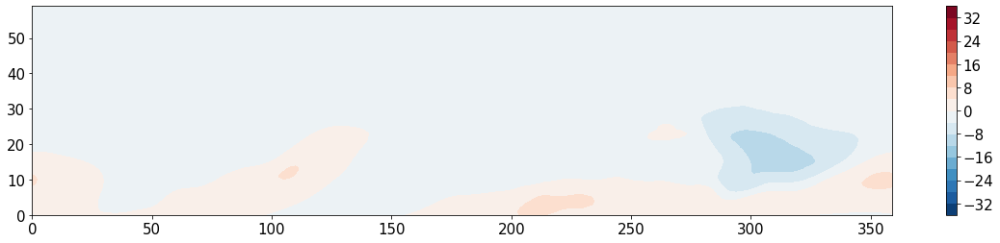

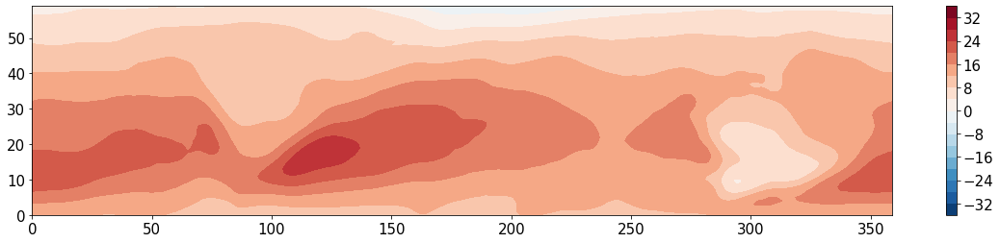

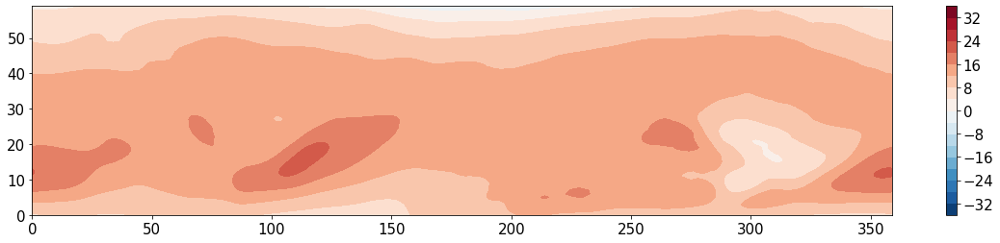

In [75]:
py.figure(figsize=(20,4))
py.contourf(cg*cos_phi, levels=np.arange(-18,20,2)*2, cmap=py.cm.RdBu_r); py.colorbar()

py.figure(figsize=(20,4))
py.contourf((u00+cg), levels=np.arange(-18,20,2)*2, cmap=py.cm.RdBu_r); py.colorbar()

py.figure(figsize=(20,4))
py.contourf((UREF[:,None]+cg), levels=np.arange(-18,20,2)*2, cmap=py.cm.RdBu_r); py.colorbar()

In [88]:
# 1

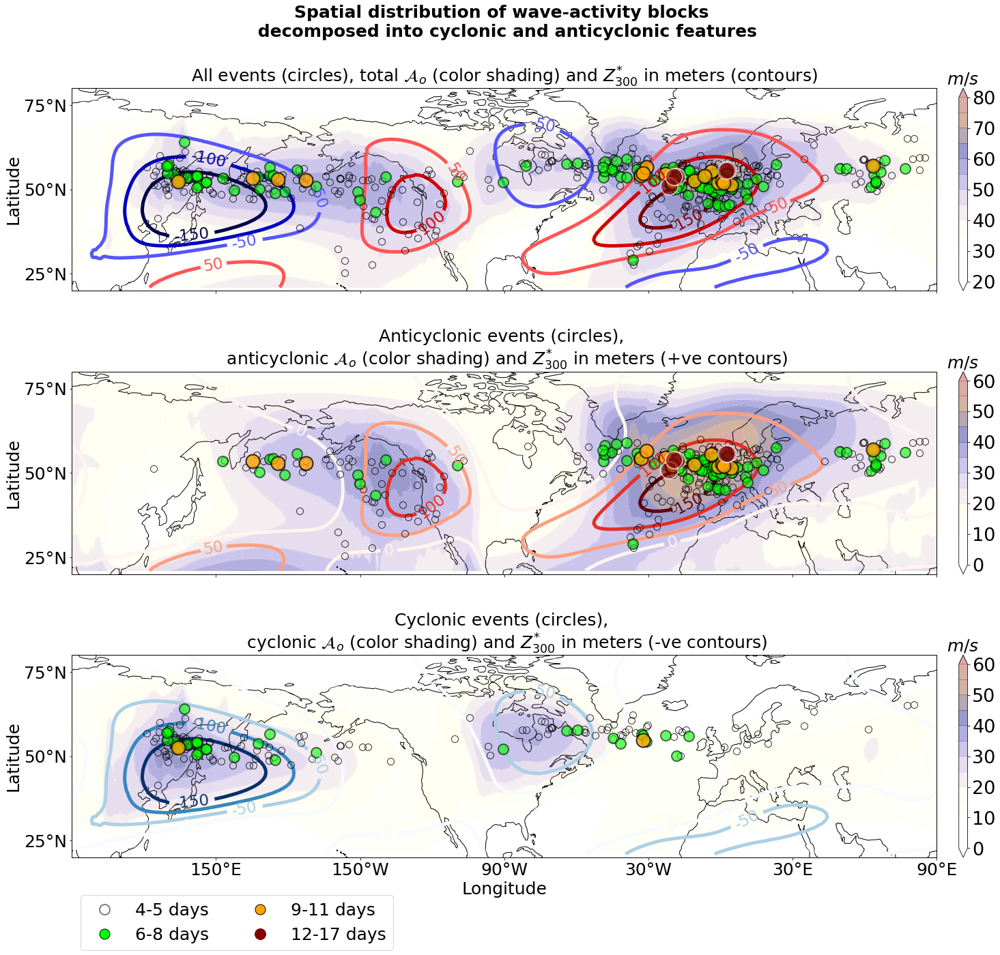

In [90]:
def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
    
    
    
VARIABLES = {'LWA'              : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'All events (circles), total $\mathcal{A}_o$ (color shading) and $Z_{300}^{*}$ in meters (contours)', \
                                   'zcontours': [-150, -100, -50, 50, 100, 150], 'zcmap': py.cm.seismic}, \
          
             'Anticyclonic LWA'  : {'EXTRA': 'BlOCK_TYPES_DIVISION_Z300_based', \
                                    'block_type':'anticyclonic', 'block_legend': False, \
                                    'title': r'Anticyclonic events (circles), '+'\n '+'anticyclonic $\mathcal{A}_o$ (color shading) and $Z_{300}^{*}$ in meters (+ve contours)', \
                                    'zcontours': [0, 50, 100, 150], 'zcmap': py.cm.Reds}, \
          
             'Cyclonic LWA'      : {'EXTRA': 'BlOCK_TYPES_DIVISION_Z300_based', \
                                    'block_type':'cyclonic', 'block_legend':     True, \
                                    'title': r'Cyclonic events (circles), '+'\n '+'cyclonic $\mathcal{A}_o$ (color shading) and $Z_{300}^{*}$ in meters (-ve contours)',\
                                    'zcontours': [-150, -100, -50, 0], 'zcmap': py.cm.Blues_r}, }

source_file = {'LWA':              nanmean(A_N_daily), \
               'Anticyclonic LWA': nanmean(aA_N['field']), \
               'Cyclonic LWA':     nanmean(cA_N['field'])}

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])


cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])


CMAP  = matplotlib.colors.LinearSegmentedColormap.from_list("", \
      ["brown", "saddlebrown", "navy", "slateblue", "thistle", "lightyellow", "white", "white",][::-1])


lrange0 = np.arange(10, 82, 2)
lrange1 = np.arange(10, 52, 2)
lranges  = [lrange0, lrange1, lrange1]

lrange0 = np.arange(20, 85, 5)
lrange1 = np.arange(0, 65, 5)
lranges  = [lrange0, lrange1, lrange1]

default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig = py.figure(figsize=(22,34))
# dest = '/data/pragallva/Spring_quarter_2020/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'

axs=[]; enum=-1
ims=[]

for  key in (VARIABLES.keys()):  
        enum = enum+1
        xlabelling = True if enum == 2 else False
        ax, im = plot_cluster_with_map_modified_for_subplots( TITLE  =  VARIABLES[key]['title'], \
                                                              DATA   =  source_file[key], \
                                                              LRANGE =  lranges[enum],           \
                                                              CMAP   =  CMAP,     \
                                                              LEGEND_LOCATION = 'lower left', \
                                                              ALPHA = 0.4, track_events=True, \
                                                              xlabelling = xlabelling, fig=fig, fig_no = 511+enum, \
                                                              EXTRA=VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                                                              block_legends = VARIABLES[key]['block_legend'], bbox_to_anchor=(0, -0.50), contour_color='w',\
                                                              zcontours = VARIABLES[key]['zcontours'], zcmap=VARIABLES[key]['zcmap'])
        axs.append(ax)
        ims.append(im)
        
        
        axins = inset_axes(ax, width="1%",   height="100%", loc=5, borderpad=-3)
        cbar =  fig.colorbar(im, cax=axins, orientation="vertical")
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(default_size_label+2)
        cbar.ax.set_title(r'$m/s$', fontsize=default_size_title)  
        
fig.subplots_adjust(left=0.1, bottom=0.1, right=0.9, 
                    top=0.9, wspace=0.2, hspace=0.4)
fig.suptitle('Spatial distribution of wave-activity blocks \n decomposed into cyclonic and anticyclonic features', fontsize = default_size_title, y=0.95,fontweight='bold')

os.makedirs(dest, exist_ok=True)
fig.savefig(dest+'Spatial_distribution_cyclonic_anticyclonic_Z300_based.png',  dpi=300, bbox_inches='tight')
fig.savefig(dest+'Spatial_distribution_cyclonic_anticyclonic_Z300_based.pdf',           bbox_inches='tight')

fig.show()

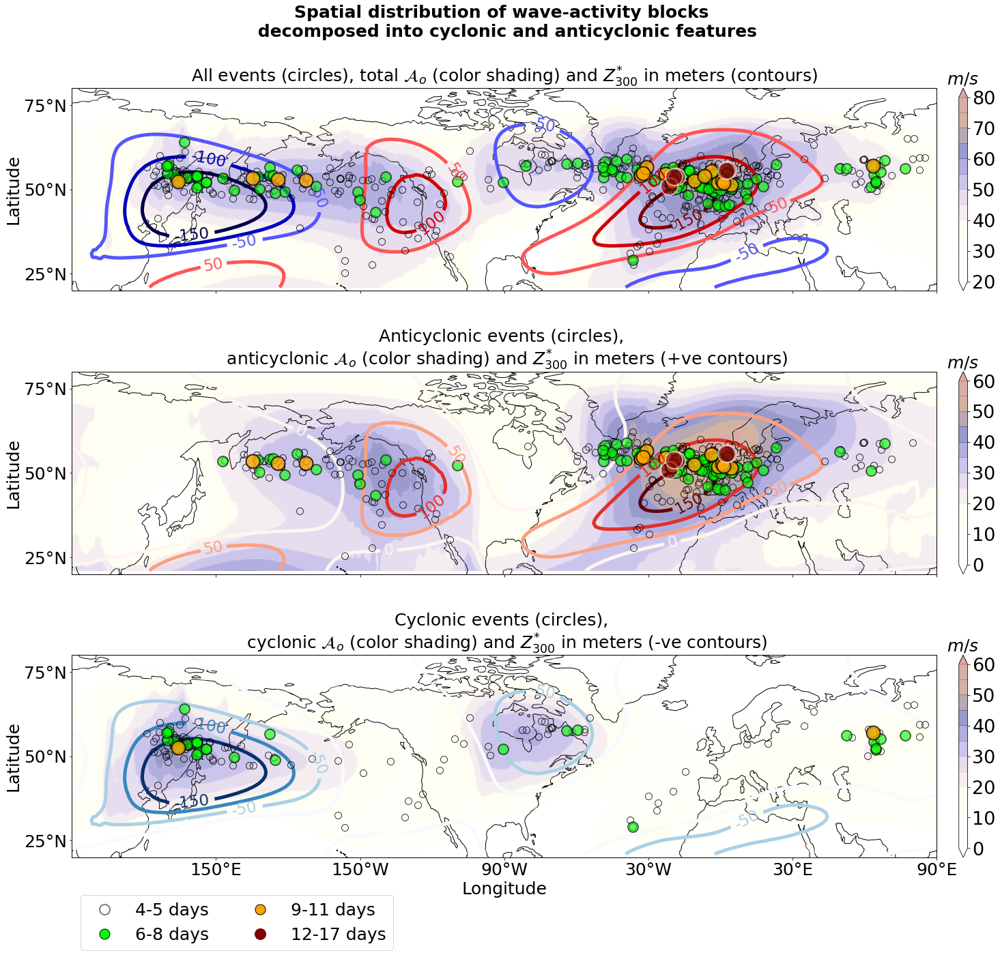

In [91]:
def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
    
    
    
VARIABLES = {'LWA'              : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'All events (circles), total $\mathcal{A}_o$ (color shading) and $Z_{300}^{*}$ in meters (contours)', \
                                   'zcontours': [-150, -100, -50, 50, 100, 150], 'zcmap': py.cm.seismic}, \
          
             'Anticyclonic LWA'  : {'EXTRA': 'BlOCK_TYPES_DIVISION_LWA_based', \
                                    'block_type':'anticyclonic', 'block_legend': False, \
                                    'title': r'Anticyclonic events (circles), '+'\n '+'anticyclonic $\mathcal{A}_o$ (color shading) and $Z_{300}^{*}$ in meters (+ve contours)', \
                                    'zcontours': [0, 50, 100, 150], 'zcmap': py.cm.Reds}, \
          
             'Cyclonic LWA'      : {'EXTRA': 'BlOCK_TYPES_DIVISION_LWA_based', \
                                    'block_type':'cyclonic', 'block_legend':     True, \
                                    'title': r'Cyclonic events (circles), '+'\n '+'cyclonic $\mathcal{A}_o$ (color shading) and $Z_{300}^{*}$ in meters (-ve contours)',\
                                    'zcontours': [-150, -100, -50, 0], 'zcmap': py.cm.Blues_r}, }

source_file = {'LWA':              nanmean(A_N_daily), \
               'Anticyclonic LWA': nanmean(aA_N['field']), \
               'Cyclonic LWA':     nanmean(cA_N['field'])}

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])


cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])


CMAP  = matplotlib.colors.LinearSegmentedColormap.from_list("", \
      ["brown", "saddlebrown", "navy", "slateblue", "thistle", "lightyellow", "white", "white",][::-1])


lrange0 = np.arange(10, 82, 2)
lrange1 = np.arange(10, 52, 2)
lranges  = [lrange0, lrange1, lrange1]

lrange0 = np.arange(20, 85, 5)
lrange1 = np.arange(0, 65, 5)
lranges  = [lrange0, lrange1, lrange1]

default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig = py.figure(figsize=(22,34))
# dest = '/data/pragallva/Spring_quarter_2020/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'

axs=[]; enum=-1
ims=[]

for  key in (VARIABLES.keys()):  
        enum = enum+1
        xlabelling = True if enum == 2 else False
        ax, im = plot_cluster_with_map_modified_for_subplots( TITLE  =  VARIABLES[key]['title'], \
                                                              DATA   =  source_file[key], \
                                                              LRANGE =  lranges[enum],           \
                                                              CMAP   =  CMAP,     \
                                                              LEGEND_LOCATION = 'lower left', \
                                                              ALPHA = 0.4, track_events=True, \
                                                              xlabelling = xlabelling, fig=fig, fig_no = 511+enum, \
                                                              EXTRA=VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                                                              block_legends = VARIABLES[key]['block_legend'], bbox_to_anchor=(0, -0.50), contour_color='w',\
                                                              zcontours = VARIABLES[key]['zcontours'], zcmap=VARIABLES[key]['zcmap'])
        axs.append(ax)
        ims.append(im)
        
        
        axins = inset_axes(ax, width="1%",   height="100%", loc=5, borderpad=-3)
        cbar =  fig.colorbar(im, cax=axins, orientation="vertical")
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(default_size_label+2)
        cbar.ax.set_title(r'$m/s$', fontsize=default_size_title)  
        
fig.subplots_adjust(left=0.1, bottom=0.1, right=0.9, 
                    top=0.9, wspace=0.2, hspace=0.4)
fig.suptitle('Spatial distribution of wave-activity blocks \n decomposed into cyclonic and anticyclonic features', fontsize = default_size_title, y=0.95,fontweight='bold')

os.makedirs(dest, exist_ok=True)
fig.savefig(dest+'Spatial_distribution_cyclonic_anticyclonic_LWA_based.png',  dpi=300, bbox_inches='tight')
fig.savefig(dest+'Spatial_distribution_cyclonic_anticyclonic_LWA_based.pdf',           bbox_inches='tight')

fig.show()

## Covariance and Flux capacity 

## $\alpha = Cov \ (A', U'\ cos\phi)$
####  where $'$ denotes removing less than 4 days 

In [39]:
dicti_AUCos.keys()

dict_keys(['slope', 'pvalue', 'rvalue', 'intercept'])

In [109]:
# np.ma?

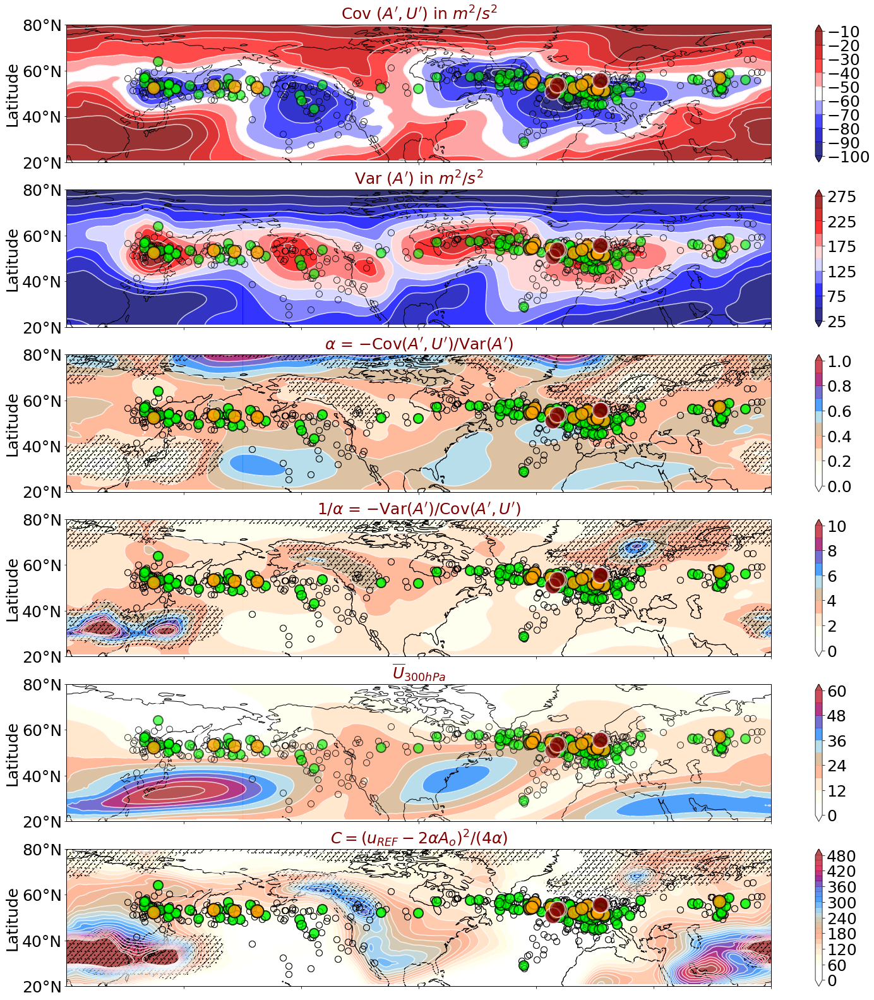

In [187]:
def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
 
cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])


cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

 
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi

# alpha   = np.ma.masked_where( np.abs(dicti_AU['rvalue']) <= 0.4, alpha)

C = ((UREF[:,None]) - (2*alpha*A0_mini))**2/(4*alpha)

LRANGE      = 10

VARIABLES   = { 'covariance_A_U'  : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'Cov $(A^\prime, U^\prime)$ in $m^2/s^2$', \
                                   'cmap': py.cm.seismic, 'var': covar_AUCos['COV']/cos_phi, 'lrange': LRANGE}, \
               
                'Variance_A'     : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'Var $(A^\prime)$ in $m^2/s^2$', \
                                   'cmap': py.cm.seismic, 'var': covar_AUCos['VARx'], \
                                   'lrange': 10}, \
               
                'alpha'           : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                     'block_legend': False, \
                                     'title' : r'$\alpha$ = $-$Cov$(A^\prime, U^\prime)$/Var$(A^\prime)$', \
                                     'cmap'  : cmap0, \
                                     'var'   : alpha, \
                                     'lrange': np.arange(0, 1.1, 0.1)}, \
               
                '1_by_alpha'      : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                     'block_legend': False, \
                                     'title': r'1/$\alpha$ = $-$Var$(A^\prime)$/Cov$(A^\prime, U^\prime)$', \
                                     'cmap': cmap0, 'var': 1/alpha, 'lrange': np.arange(0, 1.1, 0.1)*10}, \
               
                'U300'            : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                     'block_legend': False, \
                                     'title': r'$\overline{U}_{300 hPa}$', \
                                     'cmap': cmap0, 'var': nanmean(u_300), 'lrange': LRANGE}, \
                
                'C'              : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$C = {(u_{REF} - 2\alpha A_o)^2/(4\alpha)}$', \
                                   'cmap': cmap0, 'var': C, 'lrange': np.arange(0, 500, 20)}, \
               
                'r-coeff'        : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, 'title': '', 'cmap': cmap0, \
                                   'var'  : np.ma.masked_where( np.abs(dicti_AU['rvalue']) >= 0.5, dicti_AU['rvalue']), 'lrange': 10},} 


default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig = py.figure(figsize=(25,28))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'

axs=[]; enum=-1
ims=[]

for  key in (VARIABLES.keys()):
    if (key != 'r-coeff'): 
        enum = enum+1
        xlabelling = True if enum == 10 else False
             
        ax, im = plot_cluster_with_map_modified_for_subplots( \
                      TITLE  =  VARIABLES[key]['title'], \
                      DATA   =  VARIABLES[key]['var'],        \
                      LRANGE =  VARIABLES[key]['lrange'],           \
                      CMAP   =  VARIABLES[key]['cmap'],  \
                      LEGEND_LOCATION = 'lower left',    \
                      ALPHA = 0.8, track_events=True,    \
                      xlabelling = xlabelling, fig=fig, fig_no = 611+enum, \
                      EXTRA=VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                      block_legends = VARIABLES[key]['block_legend'], \
                      bbox_to_anchor=(0, -0.50), contour_color='w')
             
        axs.append(ax)
        ims.append(im)

        cbar = fig.colorbar(im, ax=ax, orientation='vertical',          shrink=1,    aspect=18)
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(default_size_label)
            
key = 'r-coeff'    
for enum in [2, 3, 5]:
        ax, im = plot_cluster_with_map_modified_for_subplots( \
                      TITLE  =  VARIABLES[key]['title'], \
                      DATA   =  VARIABLES[key]['var'],        \
                      LRANGE =  VARIABLES[key]['lrange'],           \
                      hatches = True,  \
                      LEGEND_LOCATION = 'lower left',    \
                      ALPHA = 0.8, track_events=True,    \
                      xlabelling = xlabelling, fig=fig, fig_no = 611+enum, \
                      EXTRA=VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                      block_legends = False, \
                      bbox_to_anchor=(0, -0.50), contour_color='w')

# cbar = fig.colorbar(ims[1], ax=axs[1], orientation='vertical',         shrink=1,     aspect=18)
# for t in cbar.ax.get_yticklabels():
#     t.set_fontsize(default_size_label)
                    
# fig.suptitle(r'DJF (a) covariance and (b) flux capacity in $m^2/s^2$ (colors),' + \
#              '\n Persistent LWA events (in circles)', fontsize = default_size_title, y=0.93, x=0.43, fontweight='bold')

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Wave_activity_variance.png',  dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Wave_activity_variance.pdf',           bbox_inches='tight')

fig.show()


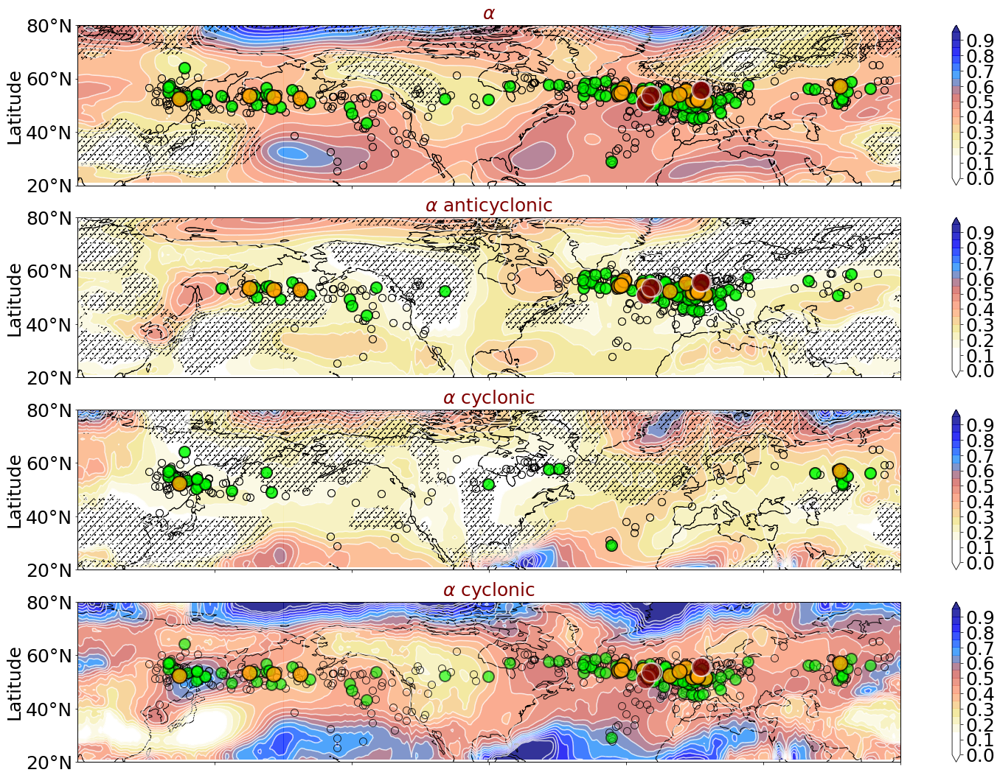

In [202]:
def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
 
cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      ["navy", "blue", "dodgerblue",  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])


# cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
#       [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

 
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi

# alpha   = np.ma.masked_where( np.abs(dicti_AU['rvalue']) <= 0.4, alpha)

C = ((UREF[:,None]) - (2*alpha*A0_mini))**2/(4*alpha)

LRANGE      = 10

VARIABLES   =  { 'alpha'           : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                      'block_legend': False, \
                                      'title' : r'$\alpha$', \
                                      'cmap'  : cmap1, \
                                      'var'   : alpha, \
                                      'lrange': np.arange(0, 1, 0.05)}, \
               
                'alpha_ac'           : {'EXTRA': 'BlOCK_TYPES_DIVISION_LWA_based', 'block_type':'anticyclonic', \
                                         'block_legend': False, \
                                         'title' : r'$\alpha$ anticyclonic', \
                                         'cmap'  : cmap1, \
                                         'var'   : -dicti_aAU['slope'], \
                                         'lrange': np.arange(0, 1, 0.05)},  \

                'alpha_c'             : {'EXTRA': 'BlOCK_TYPES_DIVISION_LWA_based', 'block_type':'cyclonic', \
                                         'block_legend': False, \
                                         'title' : r'$\alpha$ cyclonic', \
                                         'cmap'  : cmap1, \
                                         'var'   : -dicti_cAU['slope'], \
                                         'lrange': np.arange(0, 1, 0.05)}, \
                
                'alpha_total'             : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                         'block_legend': False, \
                                         'title' : r'$\alpha$ cyclonic', \
                                         'cmap'  : cmap1, \
                                         'var'   : -dicti_cAU['slope']-dicti_aAU['slope'], \
                                         'lrange': np.arange(0, 1, 0.05)},
                
                  'r-coeff'        : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                   'block_legend': False, 'title': '', 'cmap': cmap0, \
                   'var'  : np.ma.masked_where( np.abs(dicti_AU['rvalue']) >= 0.5, dicti_AU['rvalue']), 'lrange': 10},
               
                 'a-r-coeff'        : {'EXTRA': 'BlOCK_TYPES_DIVISION_LWA_based', 'block_type':'anticyclonic', \
                   'block_legend': False, 'title': '', 'cmap': cmap0, \
                   'var'  : np.ma.masked_where( np.abs(dicti_aAU['rvalue']) >= 0.3, dicti_aAU['rvalue']), 'lrange': 10},\
               
                 'c-r-coeff'        : {'EXTRA': 'BlOCK_TYPES_DIVISION_LWA_based', 'block_type':'cyclonic', \
                   'block_legend': False, 'title': '', 'cmap': cmap0, \
                   'var'  : np.ma.masked_where( np.abs(dicti_cAU['rvalue']) >= 0.3, dicti_cAU['rvalue']), 'lrange': 10},}


default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig = py.figure(figsize=(25,28))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'

axs=[]; enum=-1
ims=[]

for  key in (VARIABLES.keys()):
    if (key not in ['r-coeff', 'a-r-coeff', 'c-r-coeff']): 
        enum = enum+1
        xlabelling = True if enum == 10 else False
             
        ax, im = plot_cluster_with_map_modified_for_subplots( \
                      TITLE  =  VARIABLES[key]['title'], \
                      DATA   =  VARIABLES[key]['var'],        \
                      LRANGE =  VARIABLES[key]['lrange'],           \
                      CMAP   =  VARIABLES[key]['cmap'],  \
                      LEGEND_LOCATION = 'lower left',    \
                      ALPHA = 0.8, track_events=True,    \
                      xlabelling = xlabelling, fig=fig, fig_no = 611+enum, \
                      EXTRA = VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                      block_legends = VARIABLES[key]['block_legend'], \
                      bbox_to_anchor=(0, -0.50), contour_color='w')
             
        axs.append(ax)
        ims.append(im)

        cbar = fig.colorbar(im, ax=ax, orientation='vertical',          shrink=1,    aspect=18)
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(default_size_label)
            
# key = 'r-coeff' 
enum =-1
for key in ['r-coeff', 'a-r-coeff', 'c-r-coeff']    :
        enum=enum+1
        ax, im = plot_cluster_with_map_modified_for_subplots( \
                      TITLE  =  VARIABLES[key]['title'], \
                      DATA   =  VARIABLES[key]['var'],        \
                      LRANGE =  VARIABLES[key]['lrange'],           \
                      hatches = True,  \
                      LEGEND_LOCATION = 'lower left',    \
                      ALPHA = 0.8, track_events=True,    \
                      xlabelling = xlabelling, fig=fig, fig_no = 611+enum, \
                      EXTRA=VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                      block_legends = False, \
                      bbox_to_anchor=(0, -0.50), contour_color='w')
            
# key = 'r-coeff'    
# for enum in [2, 3, 5]:
#         ax, im = plot_cluster_with_map_modified_for_subplots( \
#                       TITLE  =  VARIABLES[key]['title'], \
#                       DATA   =  VARIABLES[key]['var'],        \
#                       LRANGE =  VARIABLES[key]['lrange'],           \
#                       hatches = True,  \
#                       LEGEND_LOCATION = 'lower left',    \
#                       ALPHA = 0.8, track_events=True,    \
#                       xlabelling = xlabelling, fig=fig, fig_no = 611+enum, \
#                       EXTRA=VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
#                       block_legends = False, \
#                       bbox_to_anchor=(0, -0.50), contour_color='w')

# cbar = fig.colorbar(ims[1], ax=axs[1], orientation='vertical',         shrink=1,     aspect=18)
# for t in cbar.ax.get_yticklabels():
#     t.set_fontsize(default_size_label)
                    
# fig.suptitle(r'DJF (a) covariance and (b) flux capacity in $m^2/s^2$ (colors),' + \
#              '\n Persistent LWA events (in circles)', fontsize = default_size_title, y=0.93, x=0.43, fontweight='bold')

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Wave_activity_variance.png',  dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Wave_activity_variance.pdf',           bbox_inches='tight')

fig.show()


In [128]:
A_N_seasonal.keys()

dict_keys(['field', 'lat', 'lon'])

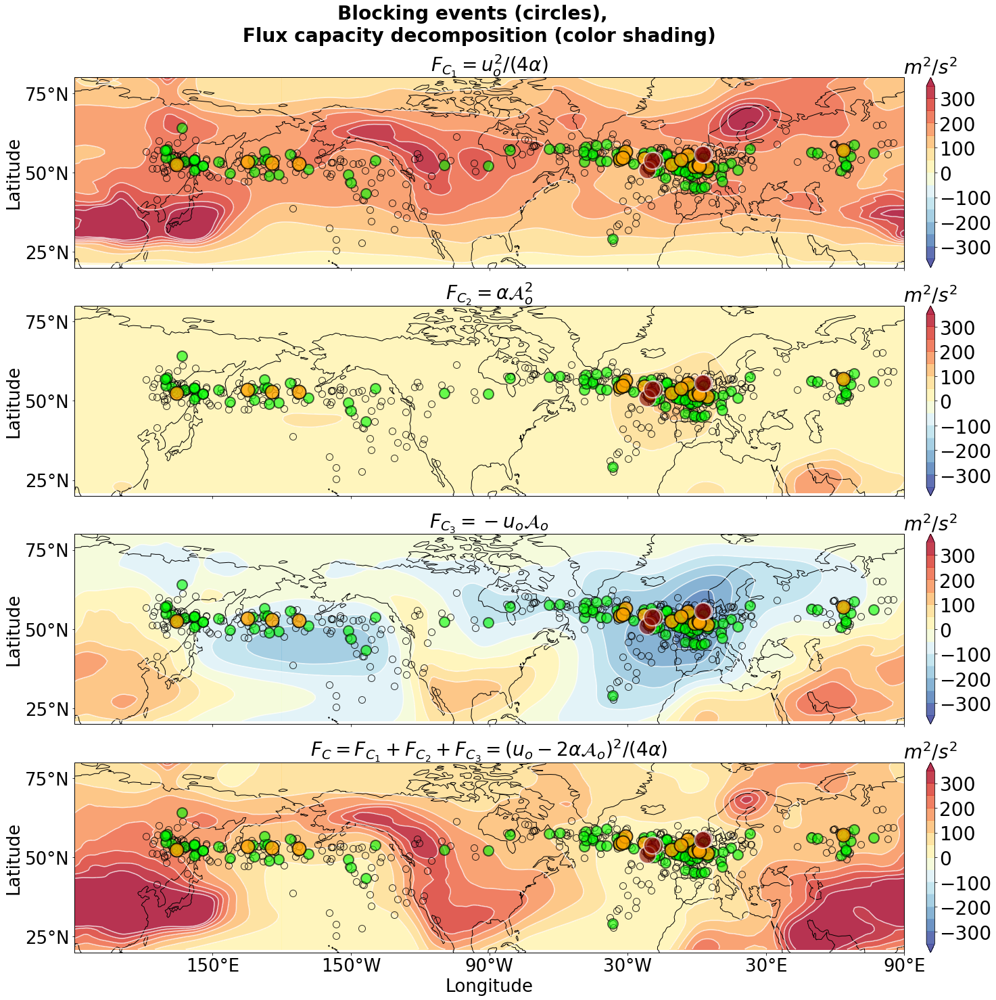

In [129]:
def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
 
cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])


cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
        ["darkred", "indianred", "pink", "white", "white","skyblue", "dodgerblue", "purple"][::-1])

cmap0 = py.cm.RdYlBu_r

LRANGE  = np.arange(-350, 400, 50)
    
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi


# A0_mini = nanmean(A_N_daily)
A0_mini     = A_N_seasonal['field'][:-1,[0,1,11],...].mean(axis=0).mean(axis=0).mean(axis=0)
C = ((UREF[:,None]) - (2*alpha*A0_mini))**2/(4*alpha)


C1 =  ((UREF[:,None]))**2/(4*alpha)
C2 =  ((A0_mini**2)*alpha)/1
C3 = - UREF[:,None]*A0_mini/(1)

C = C1+C2+C3

VARIABLES   = {'C1'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_1} = {u^2_{o}}/(4\alpha)$', \
                                   'cmap': cmap0, 'var': C1, 'lrange': LRANGE}, \
               
               'C2'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_2} = \alpha {\mathcal{A}^2_{o}}$', \
                                   'cmap': cmap0, 'var': C2, 'lrange': LRANGE}, \
               
               'C3'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_3} = -{u_{o}\mathcal{A}_o}$', \
                                   'cmap': cmap0, 'var': C3, 'lrange': LRANGE},\
               
               'C'     : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C} = F_{C_1} + F_{C_2} + F_{C_3} = {(u_{o} - 2\alpha \mathcal{A}_o)^2/(4\alpha)}$', \
                                   'cmap': cmap0, 'var': C, 'lrange': LRANGE},}

default_size_label   = 25+1
default_size_title   = 25+3
default_size_contour = 16+2

fig = py.figure(figsize=(22,30))


axs=[]; enum=-1
ims=[]

for  key in (VARIABLES.keys()): 
        enum = enum+1
        xlabelling = True if enum == 3 else False
             
        ax, im = plot_cluster_with_map_modified_for_subplots( \
                      TITLE  =  VARIABLES[key]['title'], \
                      DATA   =  VARIABLES[key]['var'],        \
                      LRANGE =  VARIABLES[key]['lrange'],           \
                      CMAP   =  VARIABLES[key]['cmap'],  \
                      LEGEND_LOCATION = 'lower left',    \
                      ALPHA  = 0.8, track_events=True,    \
                      xlabelling    = xlabelling, fig=fig, fig_no = 511+enum, \
                      EXTRA         = VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                      block_legends = VARIABLES[key]['block_legend'], \
                      bbox_to_anchor=(0, -0.50), contour_color='w')
             
        axs.append(ax)
        ims.append(im)

        axins = inset_axes(ax, width="1%",   height="100%", loc=5, borderpad=-3)
        cbar =  fig.colorbar(im, cax=axins, orientation="vertical")
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(default_size_label+2)
        cbar.ax.set_title(r'$m^2/s^2$', fontsize=default_size_title)  
            
            
# fig.suptitle(r'DJF (a) covariance and (b) flux capacity in $m^2/s^2$ (colors),' + \
#              '\n Persistent LWA events (in circles)', fontsize = default_size_title, y=0.93, x=0.43, fontweight='bold')

fig.suptitle('Blocking events (circles), \n Flux capacity decomposition (color shading)', fontsize = default_size_title, y=0.93, fontweight='bold')


dest = './'
# fig.savefig(dest+'flux_capacity_decomposition_uref.png', dpi=300, bbox_inches='tight')
# fig.savefig(dest+'flux_capacity_decomposition_uref.pdf',          bbox_inches='tight')

fig.show()


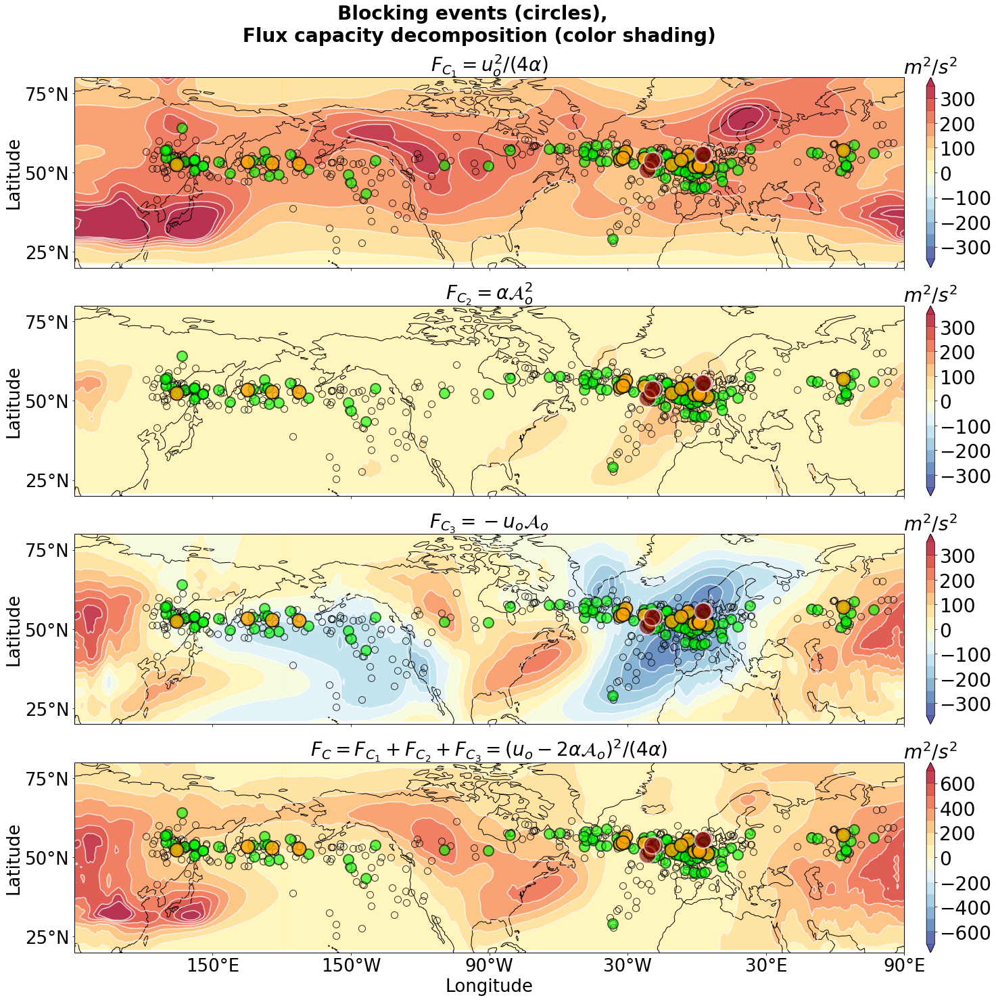

In [141]:
def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
 
cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])


cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
        ["darkred", "indianred", "pink", "white", "white","skyblue", "dodgerblue", "purple"][::-1])

cmap0 = py.cm.RdYlBu_r

LRANGE  = np.arange(-350, 400, 50)
    
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi


# A0_mini = nanmean(A_N_daily)-nanmean(A_N_daily).mean(axis=-1)[:,None]
A0_mini_full     = A_N_seasonal['field'][:-1,[0,1,11],...].mean(axis=0).mean(axis=0).mean(axis=0)+annual_mean
A0_mini     = A0_mini_full - A0_mini_full.mean(axis=-1)[:,None] 
C = ((UREF[:,None]) - (2*alpha*A0_mini))**2/(4*alpha)


# C1 =  ((UREF[:,None]))**2/(4*alpha)

C1 =  ((UREF[:,None]))**2/(4*alpha)
C2 =  ((A0_mini**2)*alpha)/1
C3 = - UREF[:,None]*A0_mini/(1)

C = C1+C2+C3

VARIABLES   = {'C1'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_1} = {u^2_{o}}/(4\alpha)$', \
                                   'cmap': cmap0, 'var': C1, 'lrange': LRANGE}, \
               
               'C2'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_2} = \alpha {\mathcal{A}^2_{o}}$', \
                                   'cmap': cmap0, 'var': C2, 'lrange': LRANGE}, \
               
               'C3'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_3} = -{u_{o}\mathcal{A}_o}$', \
                                   'cmap': cmap0, 'var': C3, 'lrange': LRANGE},\
               
               'C'     : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C} = F_{C_1} + F_{C_2} + F_{C_3} = {(u_{o} - 2\alpha \mathcal{A}_o)^2/(4\alpha)}$', \
                                   'cmap': cmap0, 'var': C, 'lrange': LRANGE*2},}

default_size_label   = 25+1
default_size_title   = 25+3
default_size_contour = 16+2

fig = py.figure(figsize=(22,30))


axs=[]; enum=-1
ims=[]

for  key in (VARIABLES.keys()): 
        enum = enum+1
        xlabelling = True if enum == 3 else False
             
        ax, im = plot_cluster_with_map_modified_for_subplots( \
                      TITLE  =  VARIABLES[key]['title'], \
                      DATA   =  VARIABLES[key]['var'],        \
                      LRANGE =  VARIABLES[key]['lrange'],           \
                      CMAP   =  VARIABLES[key]['cmap'],  \
                      LEGEND_LOCATION = 'lower left',    \
                      ALPHA  = 0.8, track_events=True,    \
                      xlabelling    = xlabelling, fig=fig, fig_no = 511+enum, \
                      EXTRA         = VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                      block_legends = VARIABLES[key]['block_legend'], \
                      bbox_to_anchor=(0, -0.50), contour_color='w')
             
        axs.append(ax)
        ims.append(im)

        axins = inset_axes(ax, width="1%",   height="100%", loc=5, borderpad=-3)
        cbar =  fig.colorbar(im, cax=axins, orientation="vertical")
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(default_size_label+2)
        cbar.ax.set_title(r'$m^2/s^2$', fontsize=default_size_title)  
            
            
# fig.suptitle(r'DJF (a) covariance and (b) flux capacity in $m^2/s^2$ (colors),' + \
#              '\n Persistent LWA events (in circles)', fontsize = default_size_title, y=0.93, x=0.43, fontweight='bold')

fig.suptitle('Blocking events (circles), \n Flux capacity decomposition (color shading)', fontsize = default_size_title, y=0.93, fontweight='bold')


dest = './'
# fig.savefig(dest+'flux_capacity_decomposition_uref.png', dpi=300, bbox_inches='tight')
# fig.savefig(dest+'flux_capacity_decomposition_uref.pdf',          bbox_inches='tight')

fig.show()


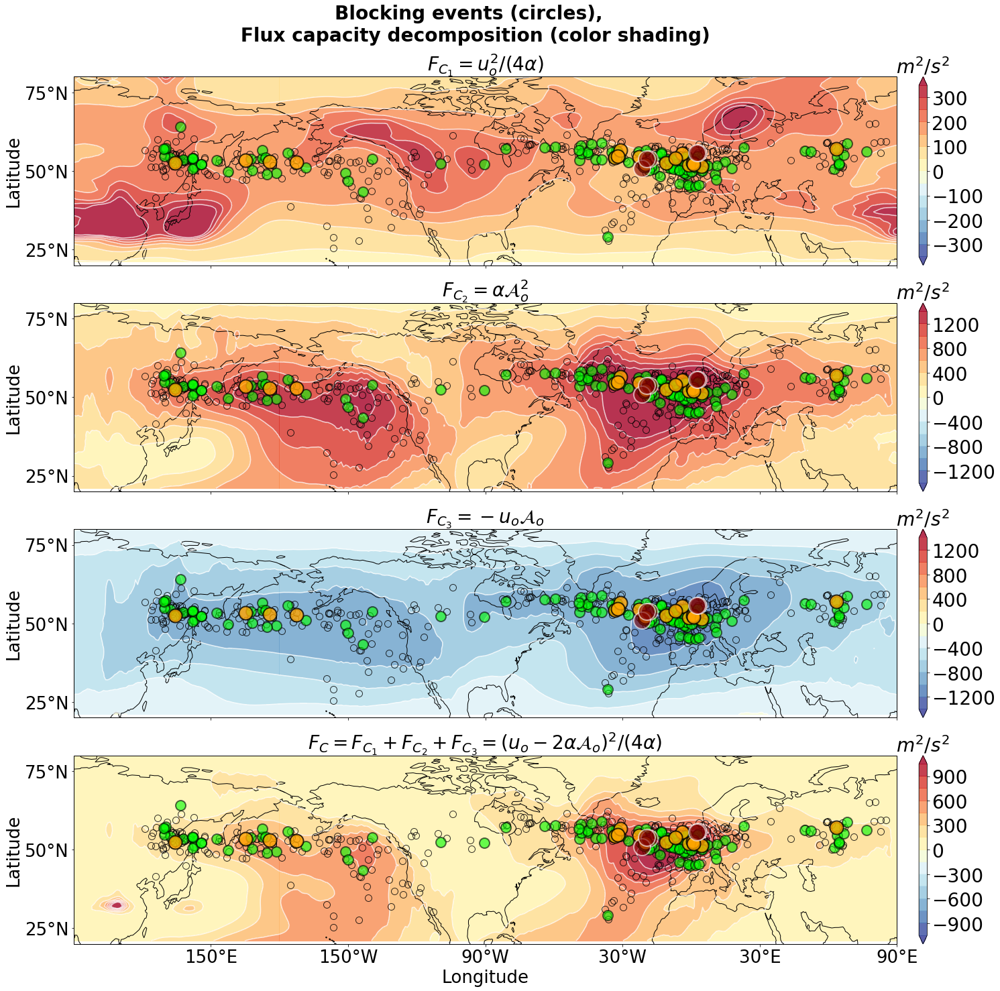

In [130]:
def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
 
cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])


cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
        ["darkred", "indianred", "pink", "white", "white","skyblue", "dodgerblue", "purple"][::-1])

cmap0 = py.cm.RdYlBu_r

LRANGE  = np.arange(-350, 400, 50)
    
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi


A0_mini = nanmean(A_N_daily)
C = ((UREF[:,None]) - (2*alpha*A0_mini))**2/(4*alpha)


C1 =  ((UREF[:,None]))**2/(4*alpha)
C2 =  ((A0_mini**2)*alpha)/1
C3 = - UREF[:,None]*A0_mini/(1)

C = C1+C2+C3

VARIABLES   = {'C1'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_1} = {u^2_{o}}/(4\alpha)$', \
                                   'cmap': cmap0, 'var': C1, 'lrange': LRANGE}, \
               
               'C2'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_2} = \alpha {\mathcal{A}^2_{o}}$', \
                                   'cmap': cmap0, 'var': C2, 'lrange': LRANGE*4}, \
               
               'C3'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_3} = -{u_{o}\mathcal{A}_o}$', \
                                   'cmap': cmap0, 'var': C3, 'lrange': LRANGE*4},\
               
               'C'     : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C} = F_{C_1} + F_{C_2} + F_{C_3} = {(u_{o} - 2\alpha \mathcal{A}_o)^2/(4\alpha)}$', \
                                   'cmap': cmap0, 'var': C, 'lrange': LRANGE*3},}

default_size_label   = 25+1
default_size_title   = 25+3
default_size_contour = 16+2

fig = py.figure(figsize=(22,30))


axs=[]; enum=-1
ims=[]

for  key in (VARIABLES.keys()): 
        enum = enum+1
        xlabelling = True if enum == 3 else False
             
        ax, im = plot_cluster_with_map_modified_for_subplots( \
                      TITLE  =  VARIABLES[key]['title'], \
                      DATA   =  VARIABLES[key]['var'],        \
                      LRANGE =  VARIABLES[key]['lrange'],           \
                      CMAP   =  VARIABLES[key]['cmap'],  \
                      LEGEND_LOCATION = 'lower left',    \
                      ALPHA  = 0.8, track_events=True,    \
                      xlabelling    = xlabelling, fig=fig, fig_no = 511+enum, \
                      EXTRA         = VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                      block_legends = VARIABLES[key]['block_legend'], \
                      bbox_to_anchor=(0, -0.50), contour_color='w')
             
        axs.append(ax)
        ims.append(im)

        axins = inset_axes(ax, width="1%",   height="100%", loc=5, borderpad=-3)
        cbar =  fig.colorbar(im, cax=axins, orientation="vertical")
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(default_size_label+2)
        cbar.ax.set_title(r'$m^2/s^2$', fontsize=default_size_title)  
            
            
# fig.suptitle(r'DJF (a) covariance and (b) flux capacity in $m^2/s^2$ (colors),' + \
#              '\n Persistent LWA events (in circles)', fontsize = default_size_title, y=0.93, x=0.43, fontweight='bold')

fig.suptitle('Blocking events (circles), \n Flux capacity decomposition (color shading)', fontsize = default_size_title, y=0.93, fontweight='bold')


# dest = './'
# fig.savefig(dest+'flux_capacity_decomposition_uref.png', dpi=300, bbox_inches='tight')
# fig.savefig(dest+'flux_capacity_decomposition_uref.pdf',          bbox_inches='tight')

fig.show()


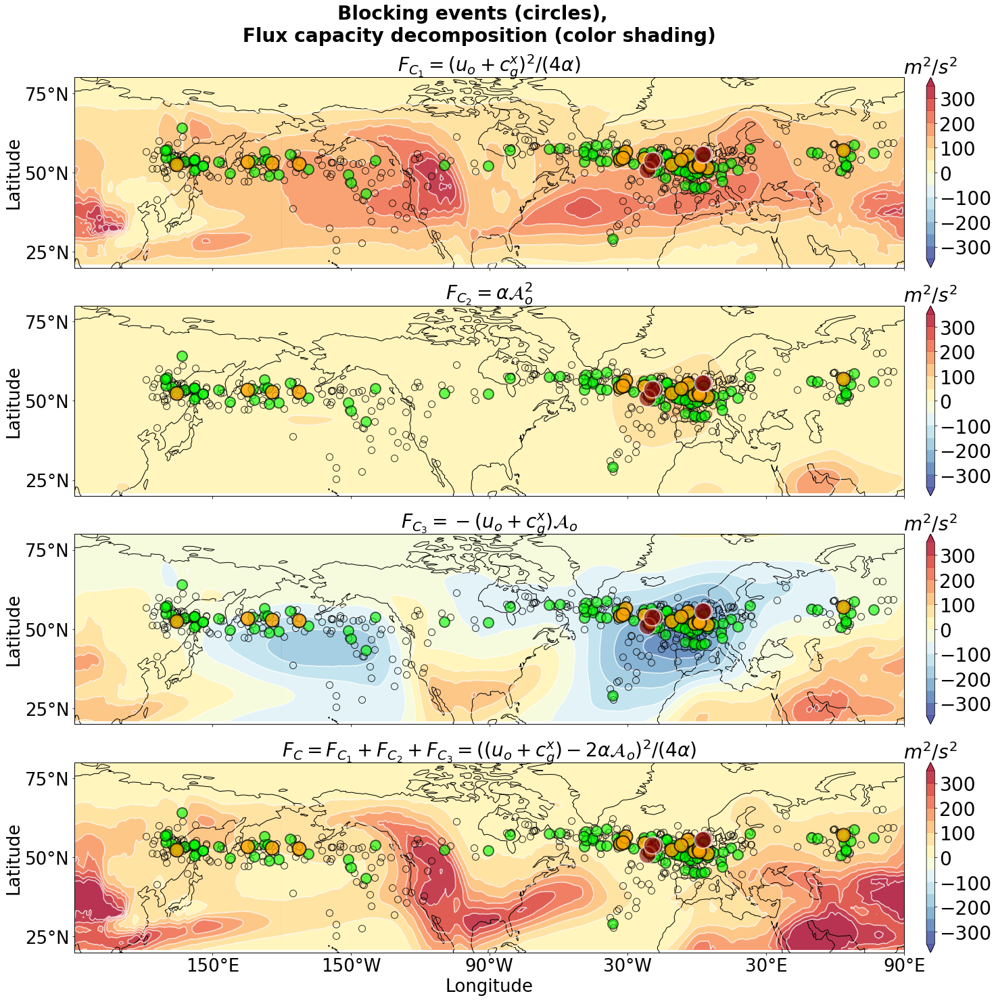

In [35]:
def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
 
cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])


cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
        ["darkred", "indianred", "pink", "white", "white","skyblue", "dodgerblue", "purple"][::-1])

cmap0 = py.cm.RdYlBu_r

LRANGE  = np.arange(-350, 400, 50)
    
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi

uref_plus_cg = A_F1F2F3_relation['linear']['slope']
C = ((uref_plus_cg) - (2*alpha*A0_mini))**2/(4*alpha)


C1 =  ((uref_plus_cg))**2/(4*alpha)
C2 =  ((A0_mini**2)*alpha)/1
C3 = - uref_plus_cg*A0_mini/(1)

C = C1+C2+C3


VARIABLES   = {'C1'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_1} = {(u_{{o}} + c{_{g}^{x}})^2}/(4\alpha)$', \
                                   'cmap': cmap0, 'var': C1, 'lrange': LRANGE}, \
               
               'C2'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_2} = \alpha {\mathcal{A}^2_{o}}$', \
                                   'cmap': cmap0, 'var': C2, 'lrange': LRANGE}, \
               
               'C3'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_3} = -({u_{{o}}+c{_{g}^{x}})\mathcal{A}_o}$', \
                                   'cmap': cmap0, 'var': C3, 'lrange': LRANGE},\
               
               'C'     : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C} = F_{C_1} + F_{C_2} + F_{C_3} = {((u_{{o}}+c{_{g}^{x}})- 2\alpha \mathcal{A}_o)^2/(4\alpha)}$', \
                                   'cmap': cmap0, 'var': C, 'lrange': LRANGE},}


default_size_label   = 25+1
default_size_title   = 25+3
default_size_contour = 16+2

fig = py.figure(figsize=(22,30))


axs=[]; enum=-1
ims=[]

for  key in (VARIABLES.keys()): 
        enum = enum+1
        xlabelling = True if enum == 3 else False
             
        ax, im = plot_cluster_with_map_modified_for_subplots( \
                      TITLE  =  VARIABLES[key]['title'], \
                      DATA   =  VARIABLES[key]['var'],        \
                      LRANGE =  VARIABLES[key]['lrange'],           \
                      CMAP   =  VARIABLES[key]['cmap'],  \
                      LEGEND_LOCATION = 'lower left',    \
                      ALPHA  = 0.8, track_events=True,    \
                      xlabelling    = xlabelling, fig=fig, fig_no = 511+enum, \
                      EXTRA         = VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                      block_legends = VARIABLES[key]['block_legend'], \
                      bbox_to_anchor=(0, -0.50), contour_color='w')
             
        axs.append(ax)
        ims.append(im)

        axins = inset_axes(ax, width="1%",   height="100%", loc=5, borderpad=-3)
        cbar =  fig.colorbar(im, cax=axins, orientation="vertical")
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(default_size_label+2)
        cbar.ax.set_title(r'$m^2/s^2$', fontsize=default_size_title)  
            
            
fig.suptitle('Blocking events (circles), \n Flux capacity decomposition (color shading)', fontsize = default_size_title, y=0.93, fontweight='bold')


dest = './'
fig.savefig(dest+'flux_capacity_decomposition_uref_cg.png', dpi=300, bbox_inches='tight')
fig.savefig(dest+'flux_capacity_decomposition_uref_cg.pdf',          bbox_inches='tight')

fig.show()


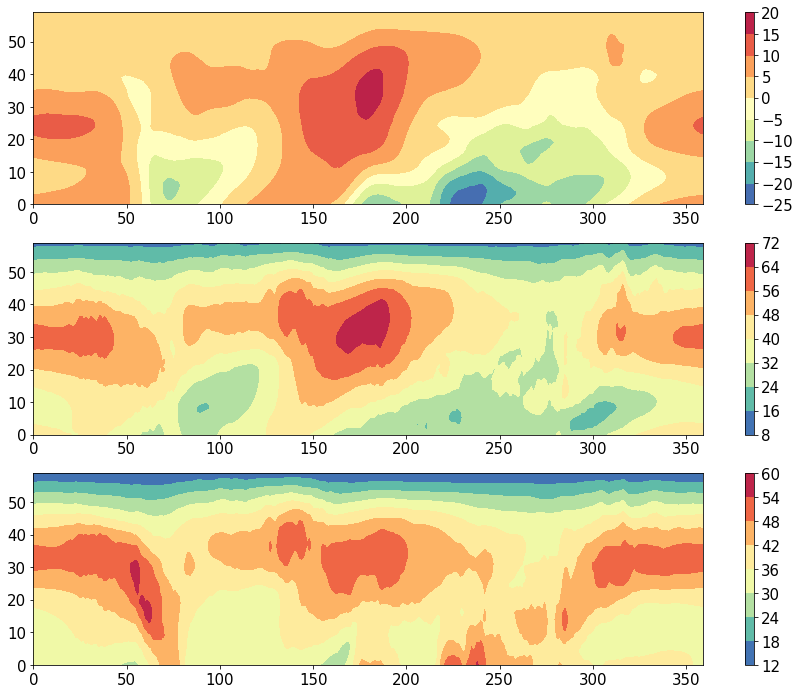

In [52]:
A0_mini     = A_N_seasonal[:,[0,1,11],...].mean(axis=0).mean(axis=0).mean(axis=0)
py.figure(figsize=(15,12))
py.subplot(3,1,1)
py.contourf(A0_mini, cmap=py.cm.Spectral_r); py.colorbar()
py.subplot(3,1,2)
py.contourf(nanmean(A_N_daily)- , cmap=py.cm.Spectral_r); py.colorbar()
py.subplot(3,1,3)
py.contourf(annual_mean, cmap=py.cm.Spectral_r); py.colorbar()


100%|██████████| 360/360 [00:12<00:00, 29.94it/s]


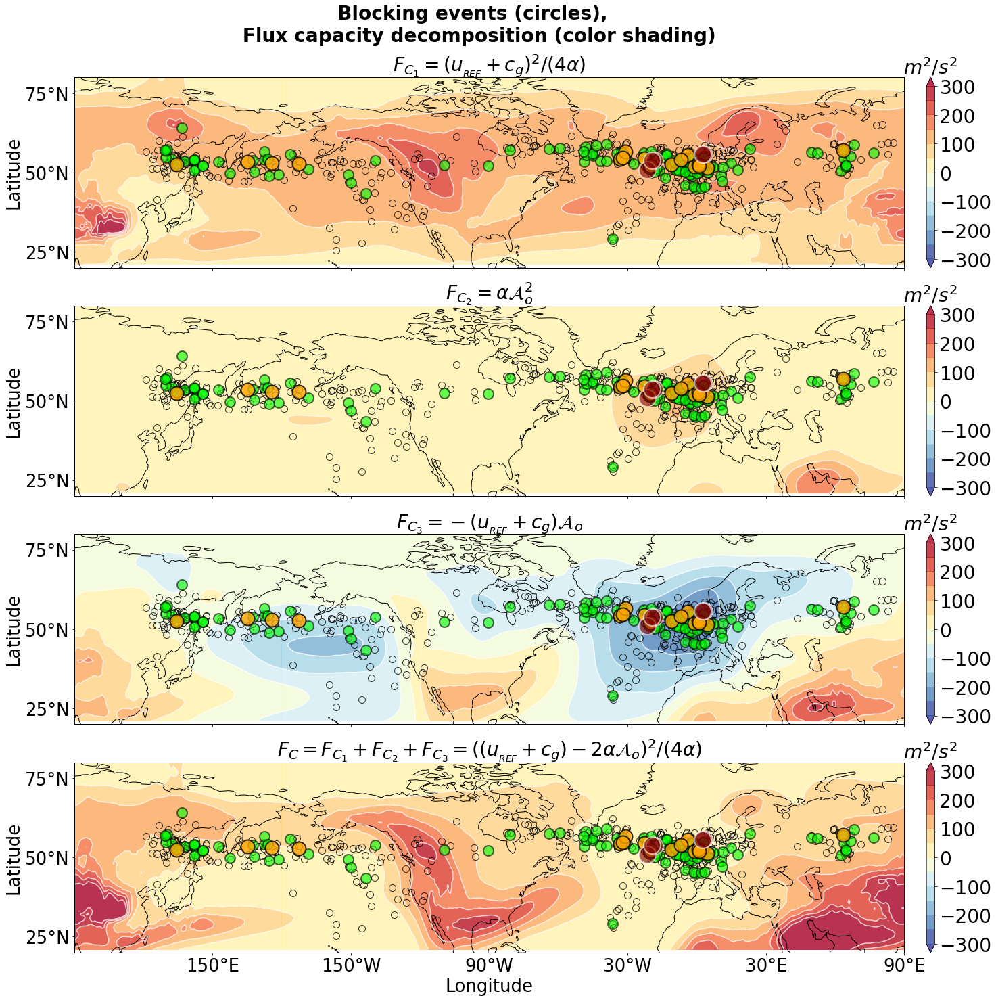

In [90]:
def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
 
cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])

cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])


cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
        ["darkred", "indianred", "pink", "white", "white","skyblue", "dodgerblue", "purple"][::-1])

cmap0 = py.cm.RdYlBu_r

LRANGE  = np.arange(-300, 350, 50)
    
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi

dict_AF3 = regression_details(A_N_unfiltered['field'][:, [11,0,1], ...], F3_N_unfiltered['field'][:, [11,0,1], ...])

cg = dict_AF3['slope']
uref_plus_cg = (UREF[:,None] +cg)
C = ((uref_plus_cg) - (2*alpha*A0_mini))**2/(4*alpha)


C1 =  ((uref_plus_cg))**2/(4*alpha)
C2 =  ((A0_mini**2)*alpha)/1
C3 = - uref_plus_cg*A0_mini/(1)

C = C1+C2+C3


VARIABLES   = {'C1'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_1} = {(u_{_{o}} + c{_{g}^{x}})^2}/(4\alpha)$', \
                                   'cmap': cmap0, 'var': C1, 'lrange': LRANGE}, \
               
               'C2'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_2} = \alpha {\mathcal{A}^2_{o}}$', \
                                   'cmap': cmap0, 'var': C2, 'lrange': LRANGE}, \
               
               'C3'    : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C_3} = -({u_{_{o}}+c{_{g}^{x}})\mathcal{A}_o}$', \
                                   'cmap': cmap0, 'var': C3, 'lrange': LRANGE},\
               
               'C'     : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'$F_{C} = F_{C_1} + F_{C_2} + F_{C_3} = {((u_{_{o}}+c{_{g}^{x}})- 2\alpha \mathcal{A}_o)^2/(4\alpha)}$', \
                                   'cmap': cmap0, 'var': C, 'lrange': LRANGE},}


default_size_label   = 25+1
default_size_title   = 25+3
default_size_contour = 16+2

fig = py.figure(figsize=(22,30))


axs=[]; enum=-1
ims=[]

for  key in (VARIABLES.keys()): 
        enum = enum+1
        xlabelling = True if enum == 3 else False
             
        ax, im = plot_cluster_with_map_modified_for_subplots( \
                      TITLE  =  VARIABLES[key]['title'], \
                      DATA   =  VARIABLES[key]['var'],        \
                      LRANGE =  VARIABLES[key]['lrange'],           \
                      CMAP   =  VARIABLES[key]['cmap'],  \
                      LEGEND_LOCATION = 'lower left',    \
                      ALPHA  = 0.8, track_events=True,    \
                      xlabelling    = xlabelling, fig=fig, fig_no = 511+enum, \
                      EXTRA         = VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                      block_legends = VARIABLES[key]['block_legend'], \
                      bbox_to_anchor=(0, -0.50), contour_color='w')
             
        axs.append(ax)
        ims.append(im)

        axins = inset_axes(ax, width="1%",   height="100%", loc=5, borderpad=-3)
        cbar =  fig.colorbar(im, cax=axins, orientation="vertical")
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(default_size_label+2)
        cbar.ax.set_title(r'$m^2/s^2$', fontsize=default_size_title)  
            
            
fig.suptitle('Blocking events (circles), \n Flux capacity decomposition (color shading)', fontsize = default_size_title, y=0.93, fontweight='bold')


dest = './'
fig.savefig(dest+'flux_capacity_decomposition_uref_const_cg.png', dpi=300, bbox_inches='tight')
fig.savefig(dest+'flux_capacity_decomposition_uref_const_cg.pdf',          bbox_inches='tight')

fig.show()


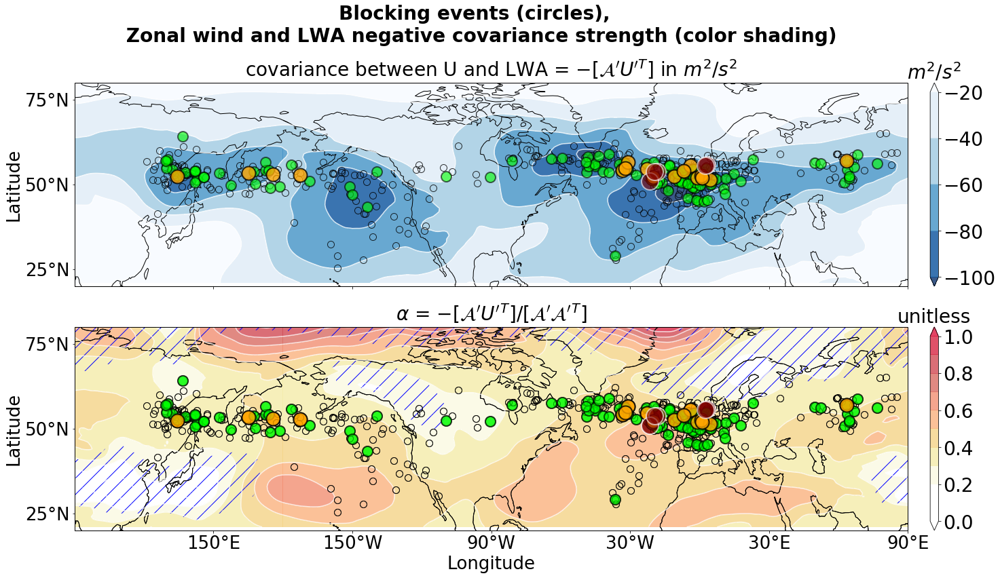

In [115]:
def nanmean(Y):
    return np.nanmean(np.nanmean(np.nanmean(Y[:,[0,1,11],...], axis=0), axis=0), axis=0)
 
cmap0 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",  "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "crimson", "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])

# cmap1 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
#       ["navy", "blue", "dodgerblue",  "indianred", "lightsalmon", "khaki", "white", "white", ][::-1])


cmap2 = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white",   "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"])

 
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi

# alpha   = np.ma.masked_where( np.abs(dicti_AU['rvalue']) <= 0.4, alpha)

C = ((UREF[:,None]) - (2*alpha*A0_mini))**2/(4*alpha)

LRANGE      = 5

VARIABLES   = { 'covariance_A_U'  : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, \
                                   'title': r'covariance between U and LWA = $-\left[\mathcal{A}^{\prime}U{}^{\prime}{}^{T}\right]$ in $m^2/s^2$', \
                                   'cmap': py.cm.Blues_r, 'var': covar_AUCos['COV']/cos_phi, 'lrange': LRANGE, \
                                    'units': r'$m^2/s^2$'}, \
               
                'alpha'           : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                     'block_legend': False, \
                                     'title' : r'$\alpha$ = $-{\left[\mathcal{A}^{\prime}U^{\prime}{}^{T}\right]}/{\left[\mathcal{A}^{\prime}\mathcal{A}^{\prime}{}^{T}\right]}$', \
                                     'cmap'  : cmap1, \
                                     'var'   : alpha, \
                                     'lrange': np.arange(0, 1.1, 0.1), 'units': 'unitless'}, \
                
                'r-coeff'        : {'EXTRA': 'DELETE_REDUNDANT_BLOCKS', 'block_type':'', \
                                   'block_legend': False, 'title': '', 'cmap': cmap0, \
                                   'var'  : np.ma.masked_where( np.abs(dicti_AU['rvalue']) >= 0.5, dicti_AU['rvalue']), 'lrange': 10},} 


default_size_label   = 25+1
default_size_title   = 25+3
default_size_contour = 16+2

fig = py.figure(figsize=(22,32))


axs=[]; enum=-1
ims=[]

for  key in (VARIABLES.keys()):
    if (key != 'r-coeff'): 
        enum = enum+1
        xlabelling = True if enum == 1 else False
             
        ax, im = plot_cluster_with_map_modified_for_subplots( \
                      TITLE  =  VARIABLES[key]['title'], \
                      DATA   =  VARIABLES[key]['var'],        \
                      LRANGE =  VARIABLES[key]['lrange'],           \
                      CMAP   =  VARIABLES[key]['cmap'],  \
                      LEGEND_LOCATION = 'lower left',    \
                      ALPHA = 0.8, track_events=True,    \
                      xlabelling = xlabelling, fig=fig, fig_no = 511+enum, \
                      EXTRA=VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                      block_legends = VARIABLES[key]['block_legend'], \
                      bbox_to_anchor=(0, -0.50), contour_color='w')
             
        axs.append(ax)
        ims.append(im)

        axins = inset_axes(ax, width="1%",   height="100%", loc=5, borderpad=-3)
        cbar =  fig.colorbar(im, cax=axins, orientation="vertical")
        for t in cbar.ax.get_yticklabels():
            t.set_fontsize(default_size_label+2)
        cbar.ax.set_title(VARIABLES[key]['units'], fontsize=default_size_title)  
        

key = 'r-coeff'    
for enum in [1]:
        
        xlabelling = True if enum == 1 else False
        ax, im = plot_cluster_with_map_modified_for_subplots( \
                      TITLE  =  VARIABLES[key]['title'], \
                      DATA   =  VARIABLES[key]['var'],        \
                      LRANGE =  VARIABLES[key]['lrange'],           \
                      hatches = True,  \
                      LEGEND_LOCATION = 'lower left',    \
                      ALPHA = 0.8, track_events=True,    \
                      xlabelling = xlabelling, fig=fig, fig_no = 511+enum, \
                      EXTRA=VARIABLES[key]['EXTRA'], block_type=VARIABLES[key]['block_type'], \
                      block_legends = False, \
                      bbox_to_anchor=(0, -0.50), contour_color='w')

                            
fig.suptitle('Blocking events (circles), \n Zonal wind and LWA negative covariance strength (color shading)', fontsize = default_size_title, y=0.93, fontweight='bold')
# fig.subplots_adjust(left=0.1, bottom=0.1, right=0.9, 
#             top=0.9, wspace=0.1, hspace=0.4)
py.rcParams.update({'hatch.color': 'b', 'hatch.linewidth':1})


dest = './'
os.makedirs(dest, exist_ok=True)
fig.savefig(dest+'alpha_estimate.png',  dpi=300, bbox_inches='tight')
fig.savefig(dest+'alpha_estimate.pdf',           bbox_inches='tight')

fig.show()


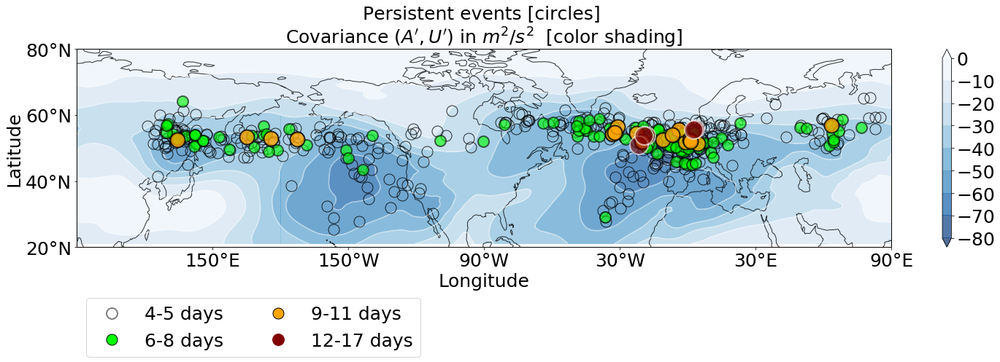

In [47]:
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"][::-1])
    
default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map(TITLE  = 'Persistent events [circles] \n'+r'Covariance $(A^\prime, U^\prime)$ in $m^2/s^2$  [color shading]' ,\
                      DATA   =  covar_AUCos['COV'], \
                      LRANGE =  np.arange(-80, 5, 10),        \
                      CMAP   =  py.cm.Blues_r,      \
                      LEGEND_LOCATION='lower left', ALPHA=0.7)

os.makedirs(dest, exist_ok=True)
fig.savefig(dest+'Covariance_cluster.png', dpi=300, bbox_inches='tight')
fig.savefig(dest+'Covariance_cluster.pdf', bbox_inches='tight')


## Stationary LWA ($A_0$)

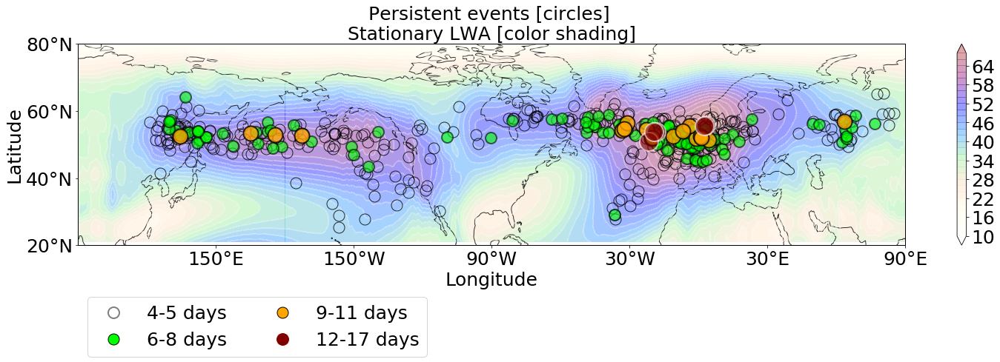

In [49]:
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"]) #[::-1]

# cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
#       [  "white",  "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])

    
default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map(TITLE  = 'Persistent events [circles] \n'+r'Stationary LWA [color shading]' ,\
                      DATA   =  (A0_mini)+annual_mean, \
                      LRANGE =  np.arange(10,70,2),    \
                      CMAP   =  cmap,      \
                      LEGEND_LOCATION='lower left', ALPHA=0.4)

os.makedirs(dest, exist_ok=True)
fig.savefig(dest+'Stationary_LWA_cluster.png',     dpi=300, bbox_inches='tight')
fig.savefig(dest+'Stationary_LWA_cluster.png.pdf', bbox_inches='tight')


## Flux capacity, C

In [21]:
Uref = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/parameters/Uref_N.hdf5')
UREF = np.nanmean (np.nanmean(np.nanmean(Uref['field'][:,[11,0,1],:,:,0],axis=0), axis=0), axis=0)

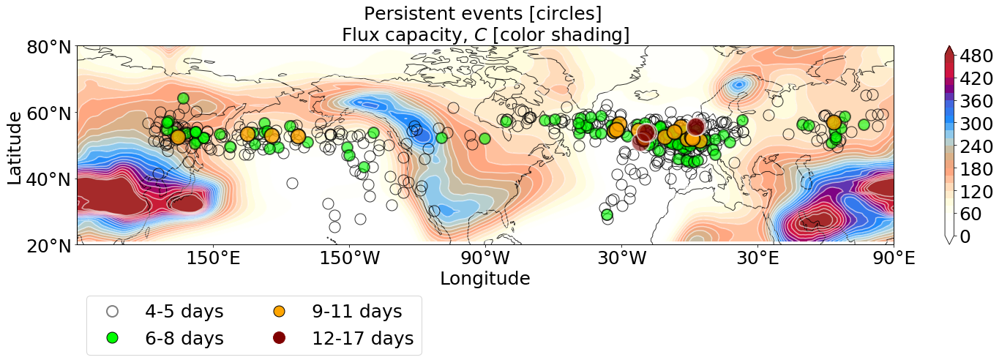

In [22]:
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi

C = ((UREF[:,None]) - (2*alpha*A0_mini))**2/(4*alpha)

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r'Flux capacity, $C$ [color shading]' ,\
                          DATA   = C, \
                          LRANGE = np.arange(0, 500, 20), \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=1, track_events=True,)

os.makedirs(dest, exist_ok=True)
fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


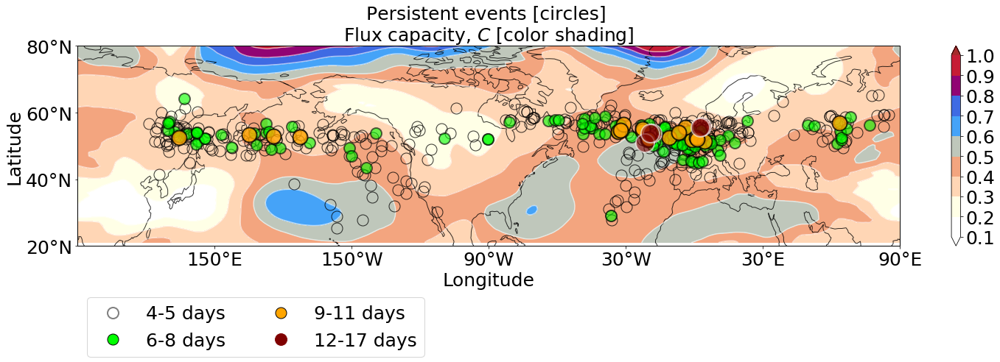

In [83]:
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi

C = ((A_F1F2F3_relation['linear']['slope']) - (2*alpha*A0_mini))**2/(4*alpha) 

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r'Flux capacity, $C$ [color shading]'  ,\
                          DATA   = alpha, \
                          LRANGE = 10, \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=1, track_events=True,)

os.makedirs(dest, exist_ok=True)
fig.savefig(dest+'alpha.png',     dpi=300, bbox_inches='tight')
fig.savefig(dest+'alpha.png.pdf', bbox_inches='tight')


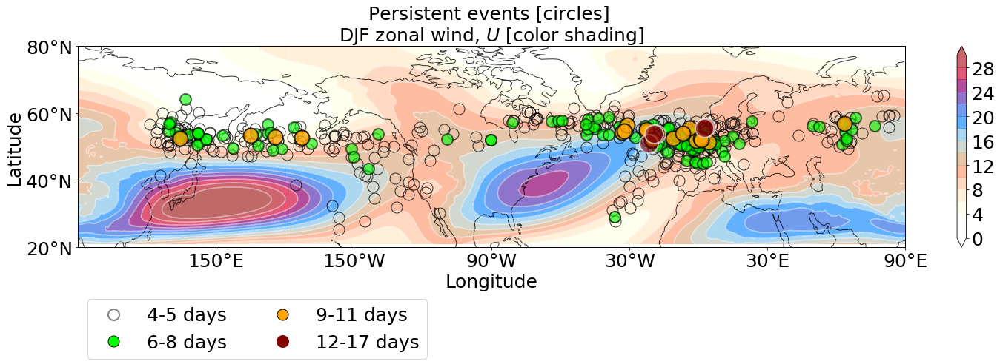

In [80]:
U_N_filtered = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/parameters/U_N.hdf5')
mean_U_N = np.nanmean(np.nanmean(np.nanmean(U_N_filtered['field'][:,[11,0,1], ...], axis=0), axis=0), axis=0)


cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])

# cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
#       [  "white", "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"]) #[::-1]


default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r'DJF zonal wind, $U$ [color shading]' ,\
                          DATA   = mean_U_N, \
                          LRANGE = np.arange(0, 32, 2), \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=0.7, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


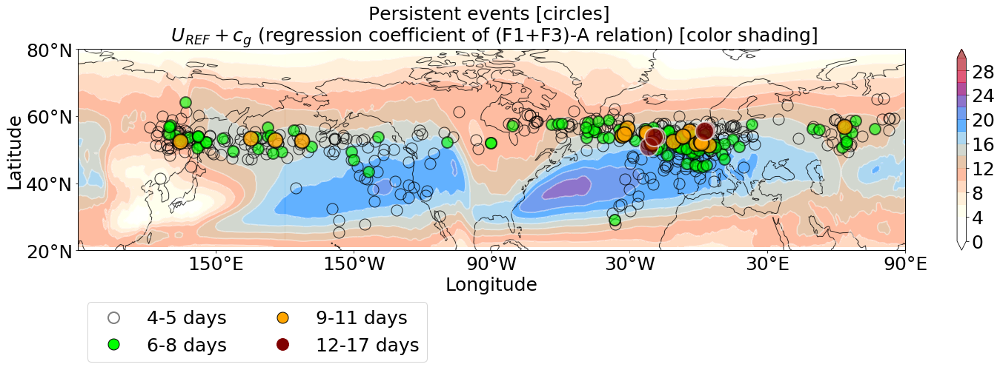

In [81]:
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])

# cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
#       [  "white", "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"]) #[::-1]


default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r' $U_{REF}+c_g$ (regression coefficient of (F1+F3)-A relation) [color shading]' ,\
                          DATA   = A_F1F2F3_relation['linear']['slope'], \
                          LRANGE = np.arange(0, 32, 2), \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=0.7, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


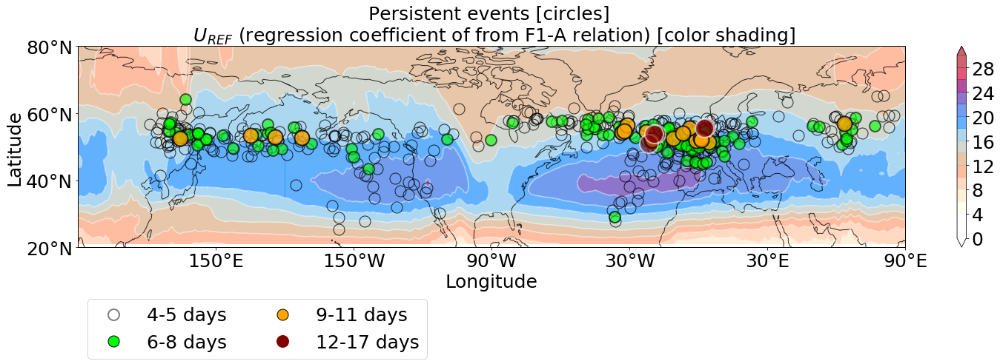

In [45]:
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])

# dict_AF1 = regression_details(A_N_unfiltered['field'][:, [11,0,1], ...], F1_N_unfiltered['field'][:, [11,0,1], ...])

default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r' $U_{REF}$ (regression coefficient of from F1-A relation) [color shading]' ,\
                          DATA   = dict_AF1 ['slope'], \
                          LRANGE = np.arange(0, 32, 2), \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=0.7, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


## Compare $c_g$ calculation

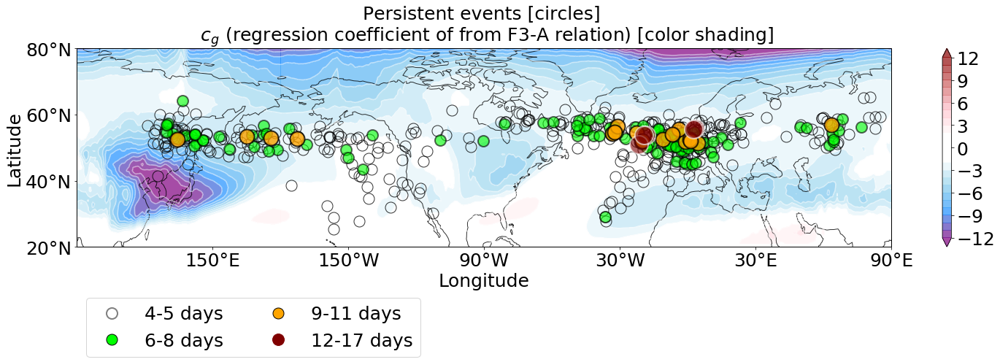

In [44]:
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "darkred", "indianred", "pink", "white", "white","skyblue", "dodgerblue", "purple"][::-1])

# dict_AF3 = regression_details(A_N_unfiltered['field'][:, [11,0,1], ...], F3_N_unfiltered['field'][:, [11,0,1], ...])

default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r' $c_{g}$ (regression coefficient of from F3-A relation) [color shading]' ,\
                          DATA   = dict_AF3 ['slope'], \
                          LRANGE = np.arange(-24, 26, 2)/2, \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=0.7, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


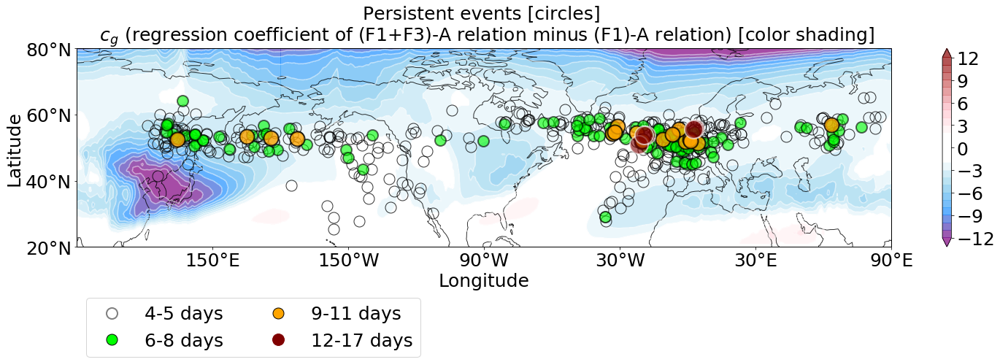

In [43]:
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "darkred", "indianred", "pink", "white", "white","skyblue", "dodgerblue", "purple"][::-1])

# cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
#       [  "white", "lightyellow", "peachpuff", "lightgreen", "dodgerblue", "blue", "purple", "brown"]) #[::-1]


default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r' $c_g$ (regression coefficient of (F1+F3)-A relation minus (F1)-A relation) [color shading]' ,\
                          DATA   = A_F1F2F3_relation['linear']['slope']-dict_AF1 ['slope'], \
                          LRANGE = np.arange(-24, 26, 2)/2, \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=0.7, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


In [47]:
U_N_filtered = h5saveload.load_dict_from_hdf5('/data/pragallva/2023_repeat_ERA5/post_processing/parameters/U_N.hdf5')
mean_U_N = np.nanmean(np.nanmean(np.nanmean(U_N_filtered['field'][:,[11,0,1], ...], axis=0), axis=0), axis=0)

### Compare latitudinal variation of Us

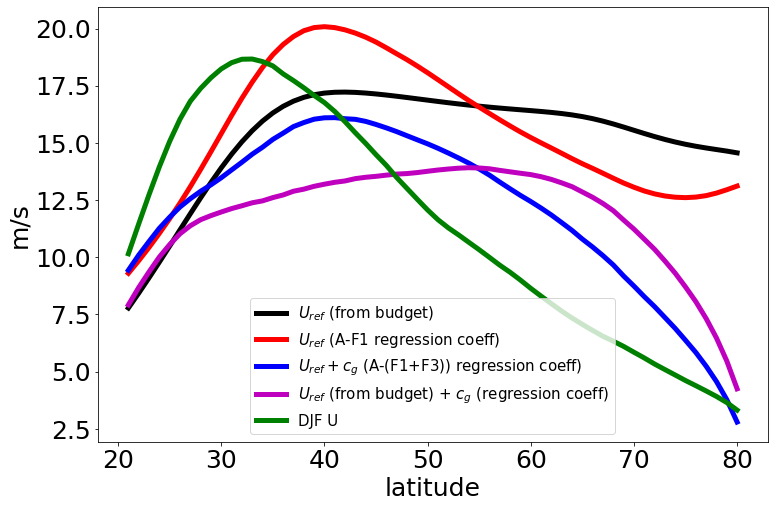

In [59]:
py.figure(figsize=(12,8))
py.plot(lat_N, UREF, 'k-', lw=5, label='$U_{ref}$ (from budget)')
py.plot(lat_N, dict_AF1['slope'].mean(axis=-1), 'r-', lw=5, label='$U_{ref}$ (A-F1 regression coeff)')
py.plot(lat_N, A_F1F2F3_relation['linear']['slope'].mean(axis=-1), 'b-', lw=5, label='$U_{ref}+c_g$ (A-(F1+F3)) regression coeff)')
# py.plot(lat_N, A_F3_relation['slope'].mean(axis=-1), 'c-', lw=5, label='$c_g$ (A-(F3)) regression coeff)')

py.plot(lat_N, UREF+A_F3_relation['slope'].mean(axis=-1), 'm-', lw=5, label='$U_{ref}$ (from budget) + $c_g$ (regression coeff)')


py.plot(lat_N, mean_U_N.mean(axis=-1), 'g-', lw=5, label='DJF U')

py.ylabel('m/s', fontsize=25)
py.xlabel('latitude', fontsize=25)
py.tick_params(labelsize=25)
py.legend(loc='lower center')
py.show()

### Comparison of flux capacity 

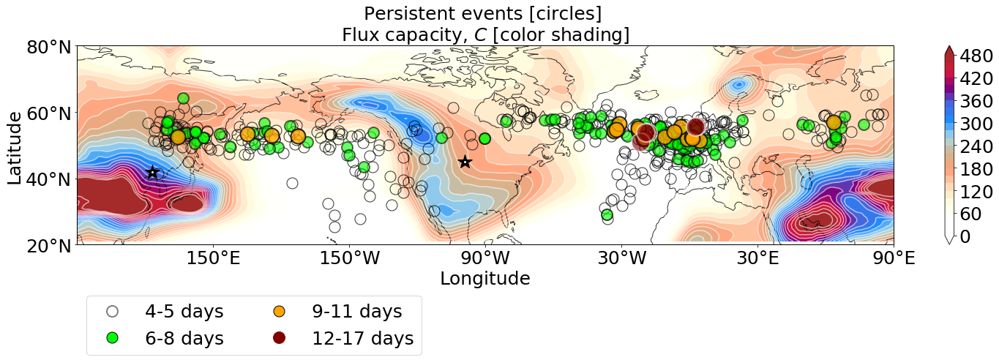

In [70]:
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi
### Here alpha is dervied from the regression coefficient between U and A

C = ((UREF[:,None]) - (2*alpha*A0_mini))**2/(4*alpha)

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r'Flux capacity, $C$ [color shading]' ,\
                          DATA   = C, \
                          LRANGE = np.arange(0, 500, 20), \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=1, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


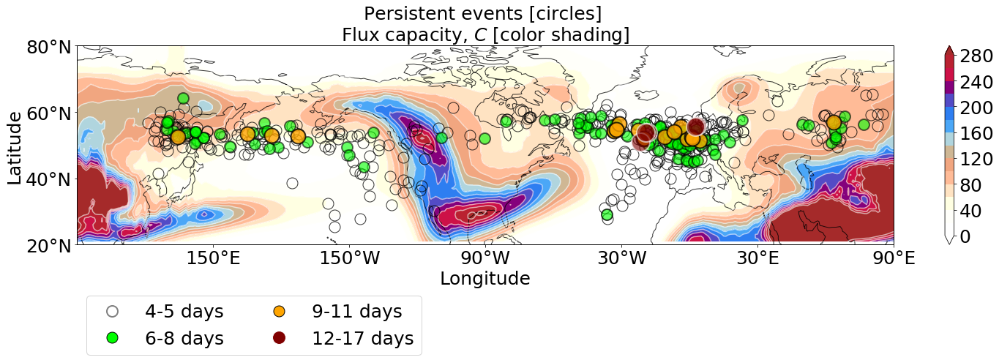

In [52]:
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi
### Here alpha is dervied from the regression coefficient between U and A
cg      = dict_AF3 ['slope']

C = ((UREF[:,None]+cg) - (2*alpha*A0_mini))**2/(4*alpha)

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r'Flux capacity, $C$ [color shading]' ,\
                          DATA   = C, \
                          LRANGE = np.arange(0, 300, 20), \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=1, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


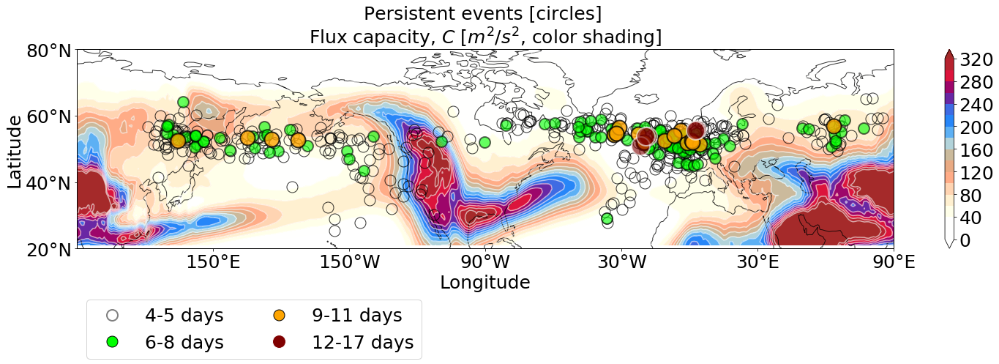

In [58]:
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi
### Here alpha is dervied from the regression coefficient between U and A

C = ((A_F1F2F3_relation['linear']['slope']) - (2*alpha*A0_mini))**2/(4*alpha) 

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r'Flux capacity, $C$ [$m^2/s^2$, color shading]' ,\
                          DATA   = C, \
                          LRANGE = np.arange(0, 340, 20), \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=1, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


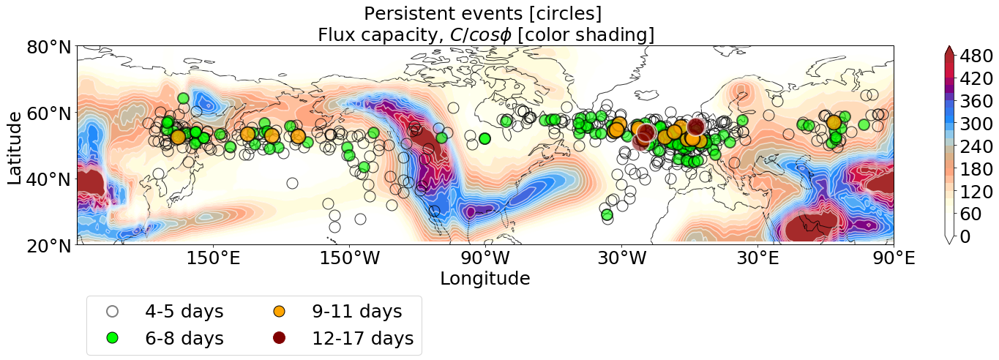

In [85]:
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi
### Here alpha is dervied from the regression coefficient between U and A

C = ((A_F1F2F3_relation['linear']['slope']) - (2*alpha*A0_mini))**2/(4*alpha) 

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r'Flux capacity, $C/cos \phi$ [color shading]' ,\
                          DATA   = C/cos_phi, \
                          LRANGE = np.arange(0, 500, 20), \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=1, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


# Lets check some probability distribution function of $F_N$

In [76]:
import seaborn as sns

In [91]:
F_N_unfiltered = F1_N_unfiltered['field'] + F2_N_unfiltered['field'] + F3_N_unfiltered['field']
F_N  = F1_N['field'] + F2_N['field'] + F3_N['field']

In [92]:
F_N_unfiltered_DJF = F_N_unfiltered[:,[11,0,1],...]
F_N_DJF = F_N[:,[11,0,1],...]

In [69]:
lon, lat = F1_N_unfiltered['lon'], F1_N_unfiltered['lat']

In [81]:
lat[(lat>40) & (lat<60)]

array([41., 42., 43., 44., 45., 46., 47., 48., 49., 50., 51., 52., 53.,
       54., 55., 56., 57., 58., 59.])

In [114]:
MEDIAN_F = np.nanmedian(F_N_unfiltered[:,[11,0,1],...].reshape(43*3*31, 60, 360), axis=0)

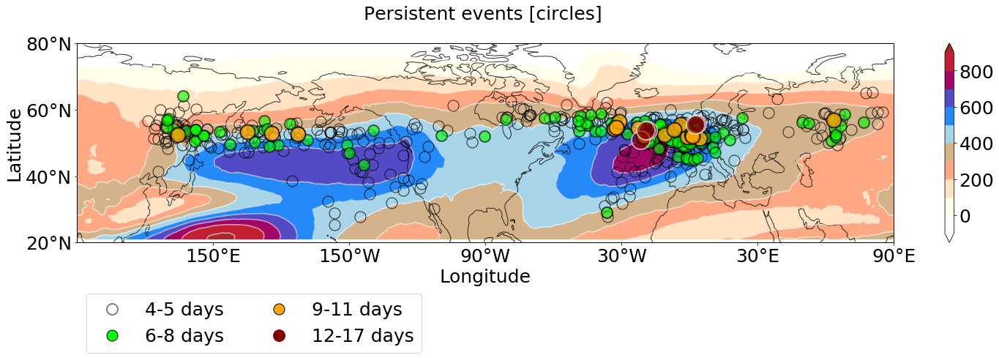

In [115]:
# MEDIAN_F = np.median(F_N_unfiltered, axes=(0,1,2))

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n',\
                          DATA   = MEDIAN_F, \
                          LRANGE = 10, \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=1, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


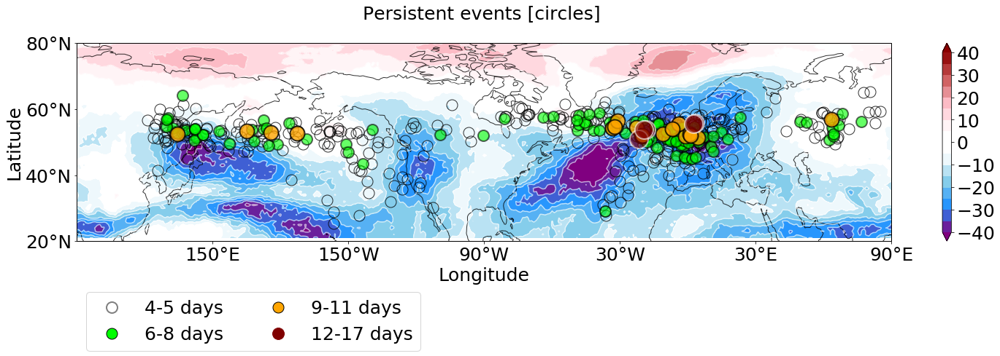

In [122]:
# MEDIAN_F = np.nanmedian(F_N[:,[11,0,1],...].reshape(43*3*31, 60, 360), axis=0)

# cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
#       [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "darkred", "indianred", "pink", "white", "white","skyblue", "dodgerblue", "purple"][::-1])


default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n',\
                          DATA   = MEDIAN_F, \
                          LRANGE = np.arange(-40,45,5), \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=1, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


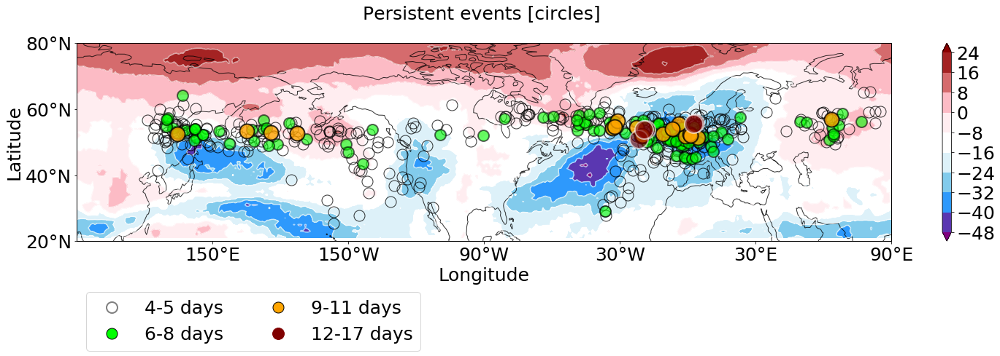

In [146]:
MEDIAN_F = np.nanmedian(F_N[:,[11,0,1],...].reshape(43*3*31, 60, 360), axis=0,)

# cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
#       [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "darkred", "indianred", "pink", "white", "white","skyblue", "dodgerblue", "purple"][::-1])

default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n',\
                          DATA   = MEDIAN_F, \
                          LRANGE = 10, \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=1, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


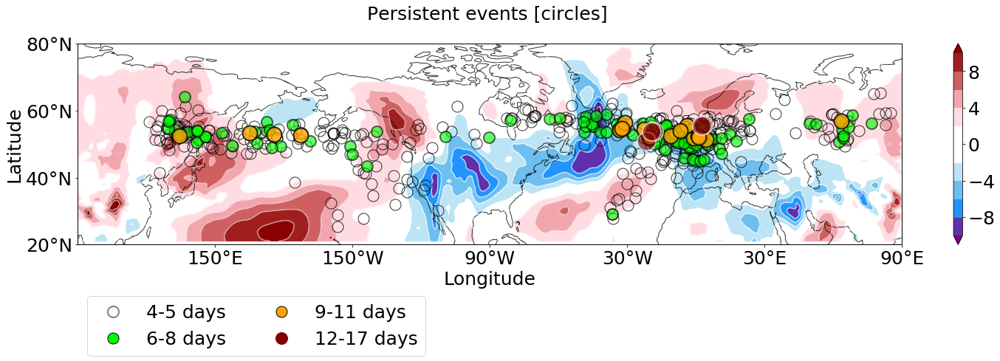

In [147]:
MEDIAN_F = np.nanmean(F_N[:,[11,0,1],...].reshape(43*3*31, 60, 360), axis=0,)

# cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
#       [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "darkred", "indianred", "pink", "white", "white","skyblue", "dodgerblue", "purple"][::-1])

default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n',\
                          DATA   = MEDIAN_F, \
                          LRANGE = 10, \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=1, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


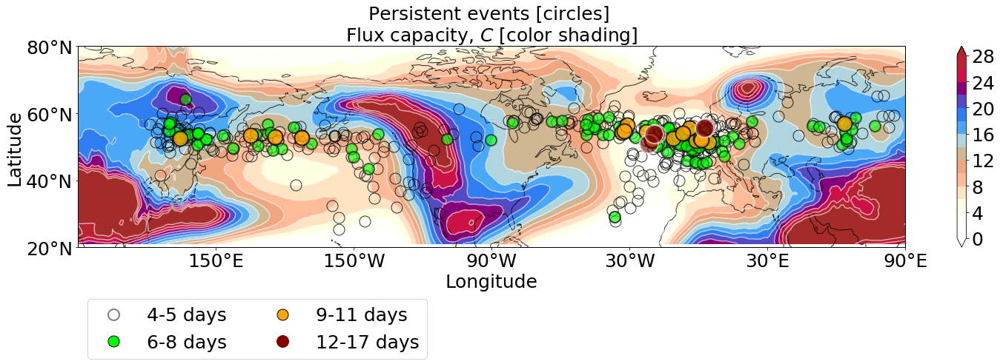

In [152]:
R       = 6371e3
dlon    = np.deg2rad(lon_N)
cos_phi = np.cos(np.deg2rad(lat_N))[:,None]
dA_dx   = np.gradient((A0_mini), dlon, axis=-1)/(2*R*cos_phi)
alpha   = -covar_AUCos['COV']/((covar_AUCos['VARx']))/cos_phi
### Here alpha is dervied from the regression coefficient between U and A
cg      = dict_AF3 ['slope']

Ac = ((UREF[:,None]+cg) - (2*alpha*A0_mini))/(2*alpha)

cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", 
      [  "white", "white", "lightyellow", "peachpuff", "lightsalmon", "tan", "lightblue", "dodgerblue", "royalblue", "purple", "crimson", "brown"])
    
default_size_label   = 25
default_size_title   = 25
default_size_contour = 16

fig  = py.figure(figsize=(25,5))
dest = '/data/pragallva/2023_repeat_ERA5/jupyter_notebooks/notebooks_to_finalise_paper_figures/paper_figures/'
plot_cluster_with_map    (TITLE='Persistent events [circles] \n'+r'Flux capacity, $C$ [color shading]' ,\
                          DATA   = Ac, \
                          LRANGE = np.arange(0,30,2), \
                          CMAP   = cmap, \
                          LEGEND_LOCATION='lower left', ALPHA=1, track_events=True,)

# os.makedirs(dest, exist_ok=True)
# fig.savefig(dest+'Flux_capacity.png',     dpi=300, bbox_inches='tight')
# fig.savefig(dest+'Flux_capacity.png.pdf', bbox_inches='tight')


In [170]:
slice1 = ((lon>-30.0) & (lon<30))
lon[slice1]

array([-29., -28., -27., -26., -25., -24., -23., -22., -21., -20., -19.,
       -18., -17., -16., -15., -14., -13., -12., -11., -10.,  -9.,  -8.,
        -7.,  -6.,  -5.,  -4.,  -3.,  -2.,  -1.,   0.,   1.,   2.,   3.,
         4.,   5.,   6.,   7.,   8.,   9.,  10.,  11.,  12.,  13.,  14.,
        15.,  16.,  17.,  18.,  19.,  20.,  21.,  22.,  23.,  24.,  25.,
        26.,  27.,  28.,  29.])

In [176]:
# slice_lon = ((lon>-30.0) & (lon<30))
# py.hist2d(A_N_unfiltered['field'][:,[11,0,1],...][..., slice_lon].flatten(), F_N_unfiltered[:,[11,0,1],...][..., slice_lon].flatten())
# py.show()

In [158]:
A_N.shape

AttributeError: 'dict' object has no attribute 'shape'

In [160]:
A_N['field'][:,[11,0,1],...].flatten().shape

(86378400,)